In [1]:
import os
base_path = './'

In [2]:
!pip install plotly
!pip install numpy==1.23.0
!pip install configobj
!pip install natsort
!pip install opencv-python-headless opencv-contrib-python-headless

In [3]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
#from google.colab.patches import cv2_imshow
import sys
import math
import collections
import matplotlib.pyplot as plt
from scipy.linalg import lstsq
from scipy.optimize import least_squares
import natsort
import plotly.graph_objects as go
from typing import Optional, Tuple, List, Union, Callable
import torch
from torch import nn
from mpl_toolkits.mplot3d import axes3d
from tqdm import trange


/tmp/ipykernel_750395/1900169006.py:10: UserWarning: A NumPy version >=1.23.5 and <2.3.0 is required for this version of SciPy (detected version 1.23.0)
  from scipy.linalg import lstsq


# Camera Calibration

## Camera Calibration Toolbox for MATLAB
From http://robots.stanford.edu/cs223b04/JeanYvesCalib/htmls/example.html

Expected output is as follows:

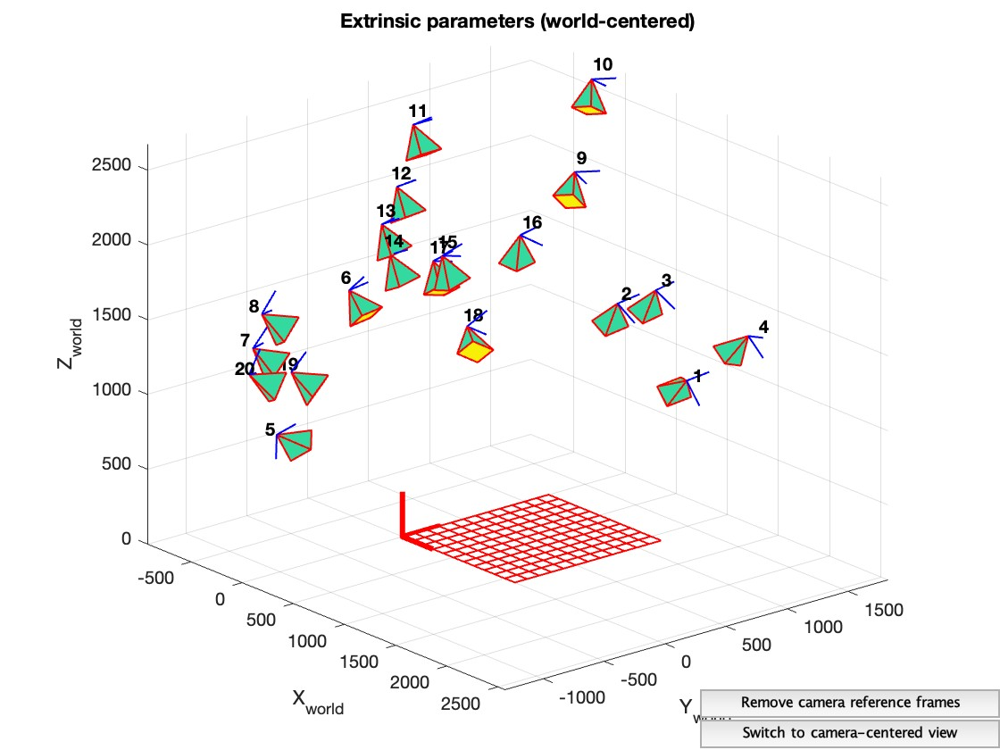

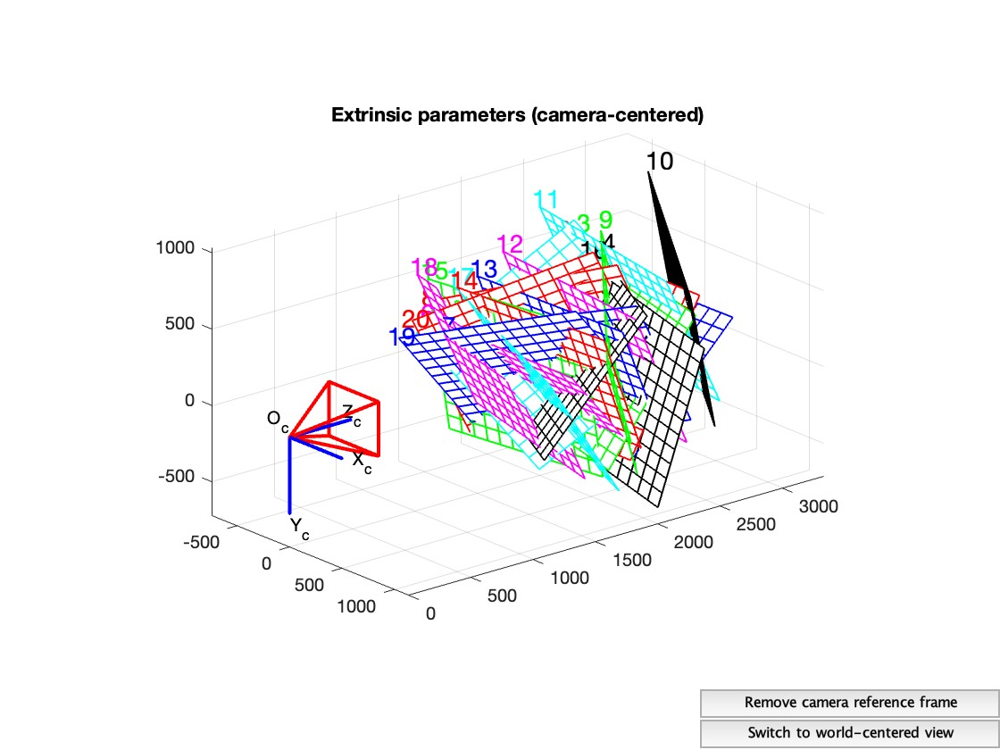

## Zhang's Method

Zhang's method를 사용해서 camera calibration process를 구현해보겠습니다.

In [4]:
images = glob.glob(os.path.join(base_path, 'checkerboard', '*.tif'))  # You can change the file extension if needed

먼저 3D 점과 2D 이미지 평면의 점을 설정해야 합니다. 체커보드는 이동하고 카메라는 고정되어 있습니다. 그러나 계산의 용이성을 위해 3D 점의 Z 좌표를 0으로 설정하고자 합니다. 따라서 체커보드는 고정되고 카메라는 이동합니다.

1.	체스보드 패턴:
체스보드는 검은색과 흰색이 번갈아가며 배열된 격자 형태의 패턴입니다. 보통 카메라 캘리브레이션을 위해 사용되며, 각 정사각형의 크기는 동일합니다.
2.	findChessboardCorners:
이 함수는 입력 이미지에서 체스보드 패턴의 코너(교차점)를 찾습니다. 이 함수는 흑백 이미지에서 명암 차이를 이용하여 코너를 검출합니다. 먼저 이미지에서 에지(윤곽선)를 검출합니다. 에지는 명암이 급격히 변하는 부분으로, 체스보드의 사각형 간 경계가 해당됩니다. OpenCV는 주로 Sobel 필터나 Canny 에지 검출기를 사용합니다.
에지 검출 후, Harris 코너 검출 알고리즘을 사용하여 이미지 내 코너점을 찾습니다. Harris 코너 검출기는 작은 창을 이동하면서 창 내 강도 변화가 큰 부분을 코너로 간주합니다.


### calibrate_camera 함수의 빈칸을 채워주세요 (10분)

In [5]:
def calibrate_camera(images, pattern_size=(5, 7)):
    obj_points = []
    img_points = []

    objp = np.zeros((np.prod(pattern_size), 3), dtype=np.float32)
    objp[:, :2] = np.indices(pattern_size).T.reshape(-1, 2)

    for image_name in images:
        img = cv2.imread(image_name)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        #######################################################################
        # CODE HERE
        ## Detect checkerboard's corners
        ## Input
        ### gray scale image, pattern size tuple
        ## Output
        ### ret: Whether or not pattern_size corners are found
        ### corners: (np.prod(pattern_size), 1, 2) array
        ## Function
        ### cv2.findChessboardCorners
        ret, corners = cv2.findChessboardCorners(gray, pattern_size)

        #######################################################################

        if ret:
            obj_points.append(objp)
            img_points.append(corners)

            #######################################################################
            # CODE HERE
            ## Draw and display the corners
            ## Function
            ### cv2.drawChessboardCorners
            img_with_corners = cv2.drawChessboardCorners(img, pattern_size, corners, ret)

            #######################################################################
            plt.figure(figsize=(8, 6))
            plt.imshow(cv2.cvtColor(img_with_corners, cv2.COLOR_BGR2RGB))
            plt.title(f"Detected corners in {image_name}")
            plt.show()

    if len(obj_points) > 0:
        #######################################################################
        # CODE HERE
        ## Obtain the K, R, and T
        ## Function
        ### cv2.calibrateCamera
        ret, K, dist_coeffs, rvec, tvec = cv2.calibrateCamera(obj_points, img_points, gray.shape[::-1], None, None)

        #######################################################################
        return K, dist_coeffs, rvec, tvec
    else:
        print("No valid chessboard patterns detected. Please check your images and pattern size.")
        return None, None, None, None

Calibration pattern을 visualization 해보겠습니다.

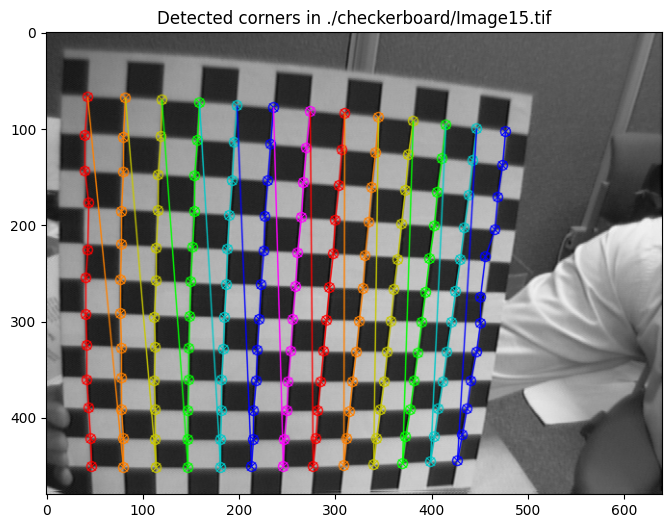

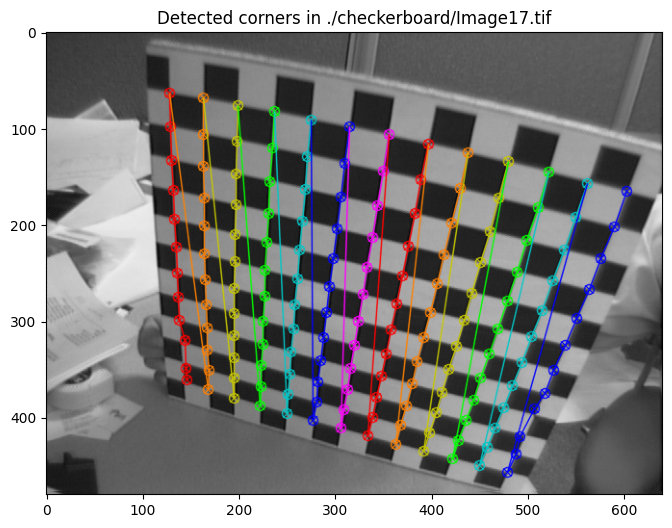

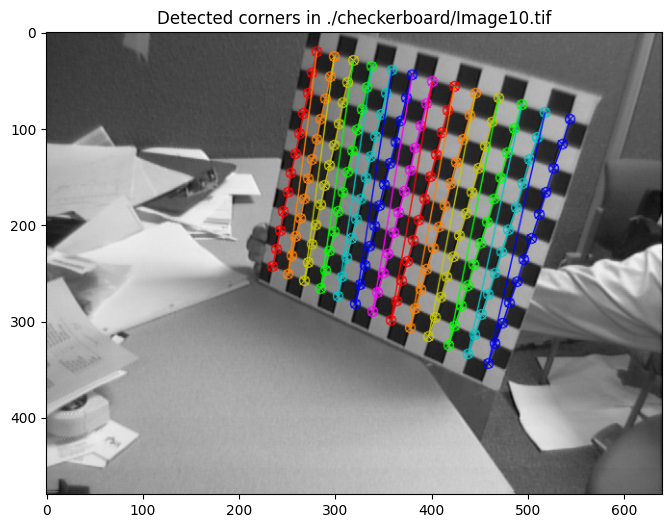

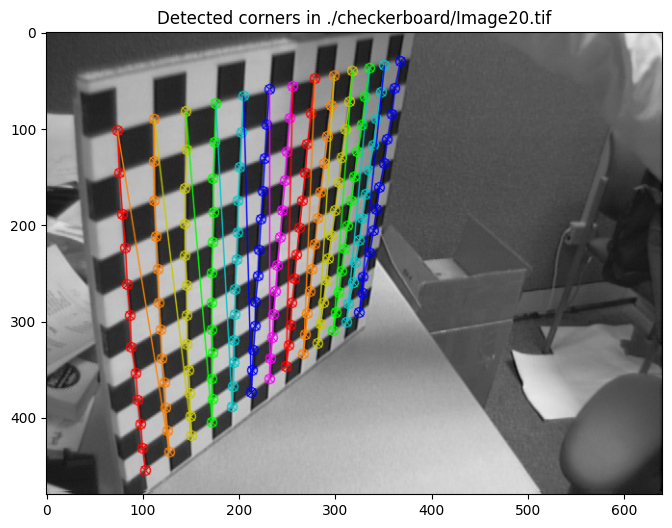

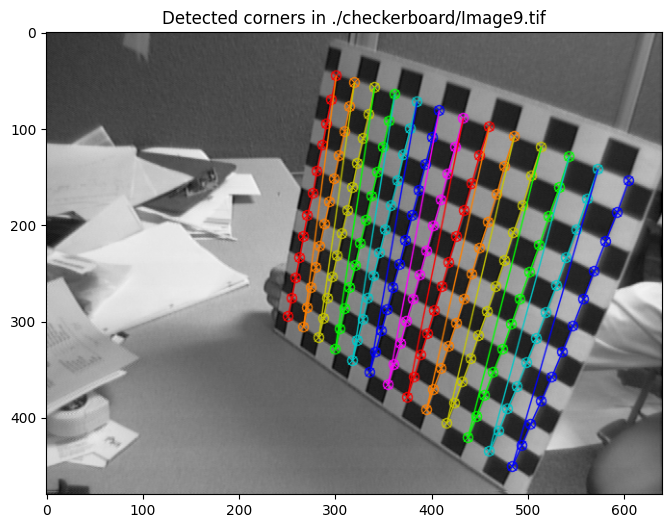

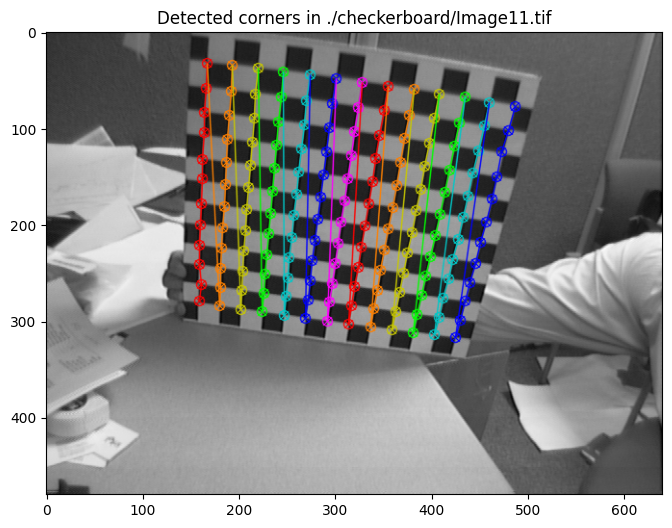

In [6]:
pattern_size = (12, 13) # check board pattern size : row 12, col 13
K, dist_coeffs, rvec, tvec = calibrate_camera(images, pattern_size)

obtained camera parameters의 값을 보이겠습니다.

In [7]:
print("Camera matrix (K):\n", K)
print("\nDistortion coefficients:\n", dist_coeffs)
print("\nRotation matrices (R1):\n", cv2.Rodrigues(rvec[0])[0])
print("\nRotation matrices (R2):\n", cv2.Rodrigues(rvec[1])[0])
print("\nRotation matrices (R3):\n", cv2.Rodrigues(rvec[2])[0])
print("\nRotation matrices (R4):\n", cv2.Rodrigues(rvec[3])[0])
print("\nTranslation vectors (t1):\n", tvec[0])
print("\nTranslation vectors (t2):\n", tvec[1])
print("\nTranslation vectors (t3):\n", tvec[2])
print("\nTranslation vectors (t4):\n", tvec[3])

Camera matrix (K):
 [[650.63423786   0.         301.56532071]
 [  0.         652.69620771 243.09837729]
 [  0.           0.           1.        ]]

Distortion coefficients:
 [[-2.82339481e-01  2.80784406e-01  1.58986866e-04  4.86816048e-04
  -1.66718621e-01]]

Rotation matrices (R1):
 [[ 0.08801977  0.97596422 -0.19936489]
 [-0.97035255  0.03878142 -0.23856222]
 [-0.22509653  0.21445242  0.9504429 ]]

Rotation matrices (R2):
 [[ 0.10288376  0.958851    0.26461236]
 [-0.80768323  0.23580034 -0.5404128 ]
 [-0.58057104 -0.15812326  0.7987079 ]]

Rotation matrices (R3):
 [[ 0.21459459  0.83711796  0.50317261]
 [-0.9116468   0.35654984 -0.20438276]
 [-0.3504986  -0.41485627  0.83966958]]

Rotation matrices (R4):
 [[ 0.11426237  0.58559509 -0.80251012]
 [-0.84722507 -0.36441115 -0.38654132]
 [-0.51880034  0.72407383  0.45449236]]

Translation vectors (t1):
 [[-7.57839313]
 [ 6.16761412]
 [18.15917948]]

Translation vectors (t2):
 [[-5.60833344]
 [ 4.25238547]
 [22.54611713]]

Translation vec

구한 K, R, and T를 이용해서 undistorted image를 표시해보겠습니다.
1. cv2.getOptimalNewCameraMatrix 함수는 카메라 캘리브레이션 후에 얻은 카메라 매트릭스와 왜곡 계수를 사용하여 새로운 카메라 매트릭스를 계산합니다. 이 새로운 매트릭스는 원래의 왜곡된 이미지를 왜곡이 제거된 이미지로 변환할 때, 불필요한 검은 테두리를 최소화하고 최대한의 유효 이미지 영역을 확보하도록 최적화됩니다.
2. cv2.undistort 함수는 이미지에서 렌즈 왜곡을 제거하는 데 사용됩니다. 이 함수는 카메라 캘리브레이션을 통해 얻은 카메라 매트릭스와 왜곡 계수를 사용하여 왜곡된 이미지를 보정합니다. 이 과정을 통해 이미지의 직선이 왜곡 없이 그대로 표현됩니다.

### undistortion 함수를 작성해주세요. (10분)

In [8]:
def visualize_undistortion(image_name, K, dist_coeffs):
    img = cv2.imread(image_name)
    h, w = img.shape[:2]

    #######################################################################
    # CODE HERE
    ## get optimal camera matrix
    ## Function
    ### cv2.getOptimalNewCameraMatrix
    new_K, roi = cv2.getOptimalNewCameraMatrix(K, dist_coeffs, (w, h), 1, (w, h))
    #######################################################################

    #######################################################################
    # CODE HERE
    ## undistortion
    ## Function
    ### cv2.undistort
    undistorted = cv2.undistort(img, K, dist_coeffs, None, new_K)
    #######################################################################

    x, y, w, h = roi
    undistorted = undistorted[y:y+h, x:x+w]

    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[1].imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    axes[1].set_title("Undistorted")
    plt.show()

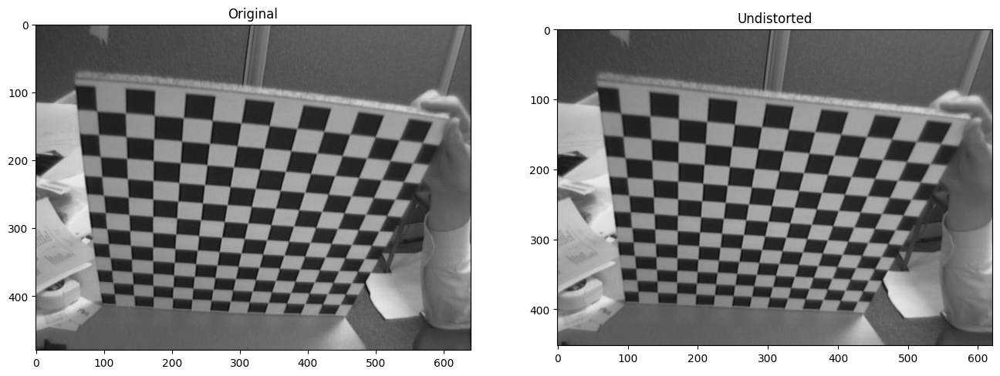

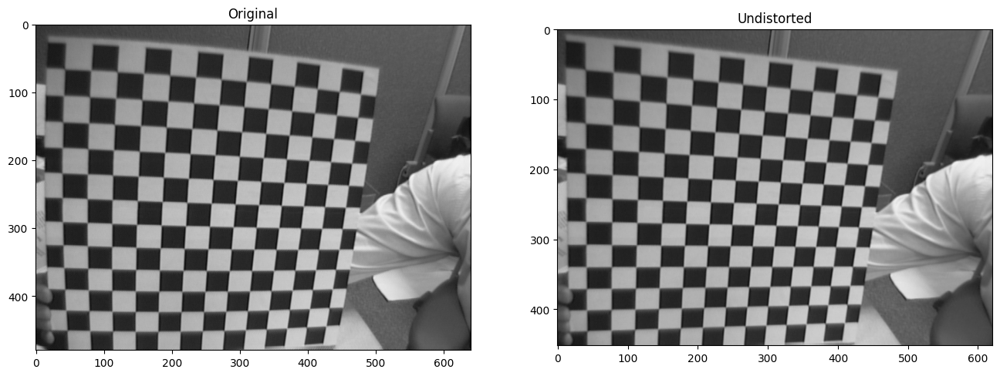

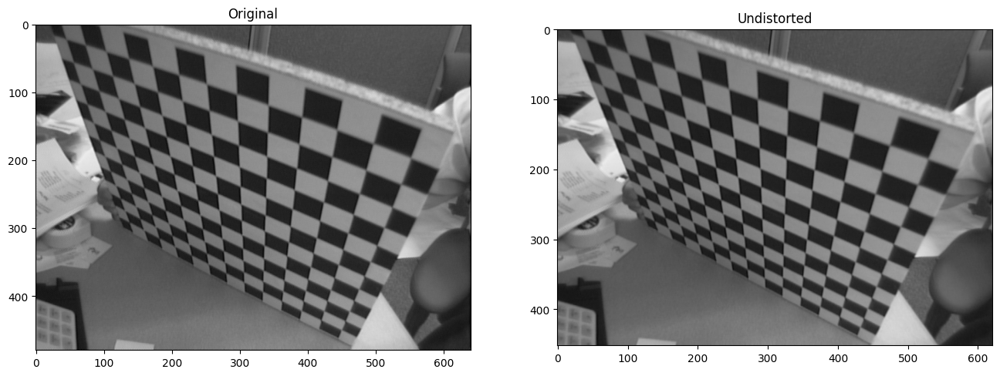

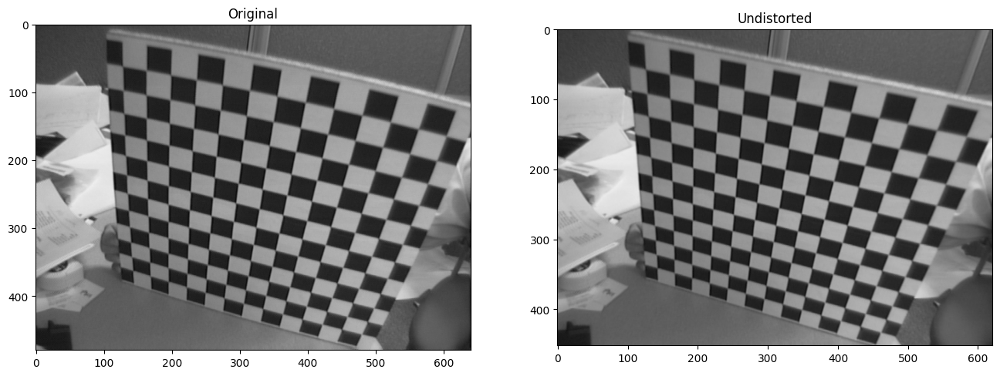

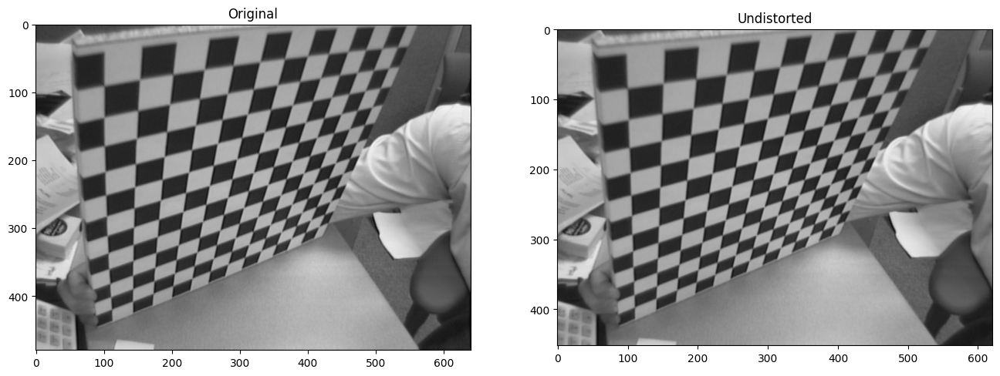

...

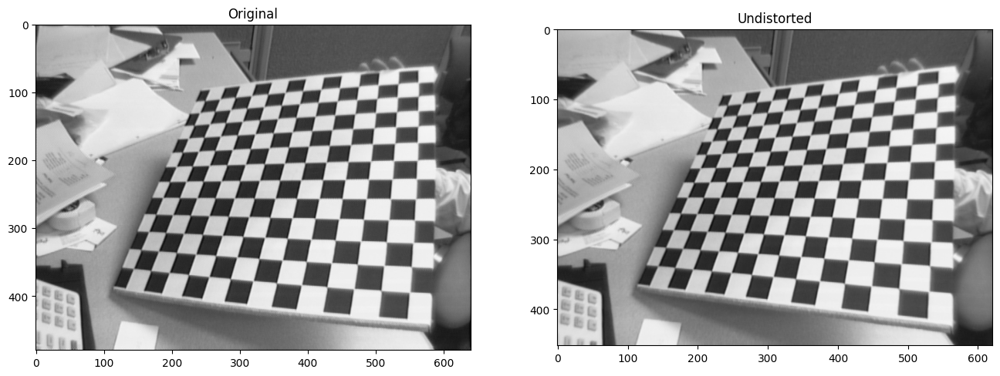

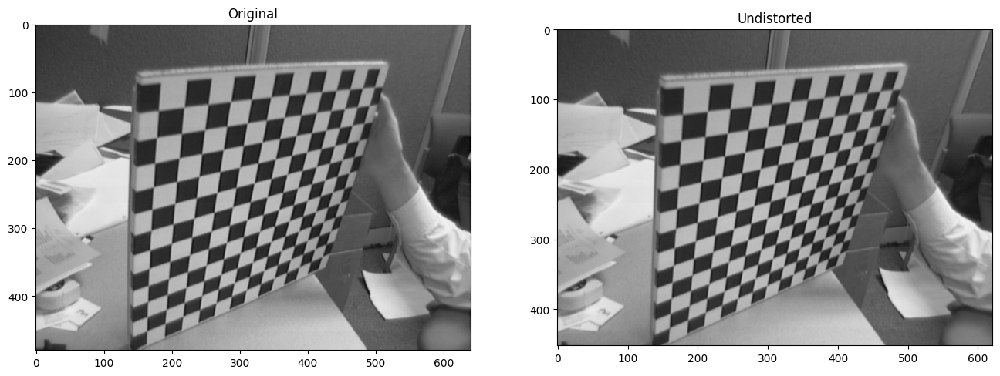

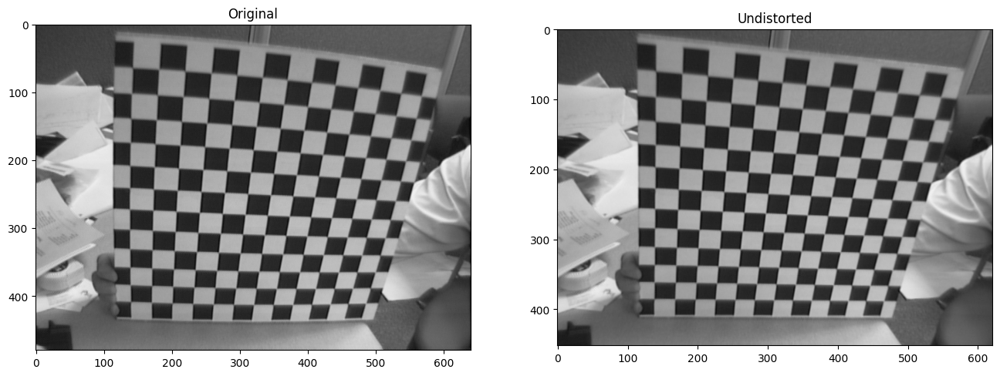

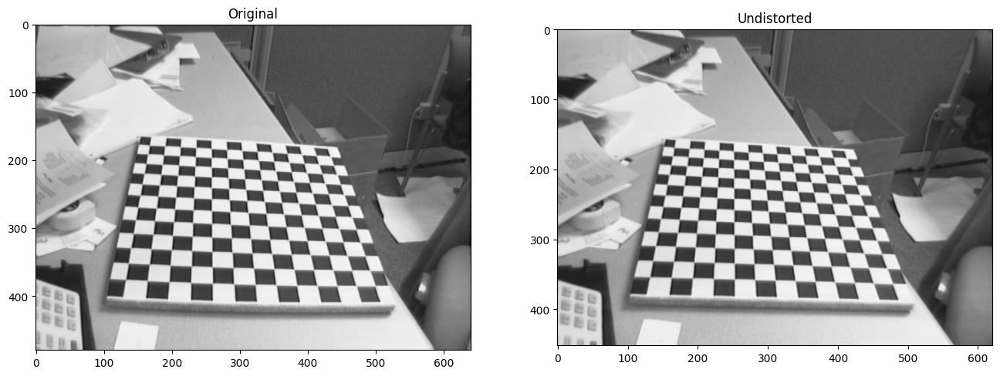

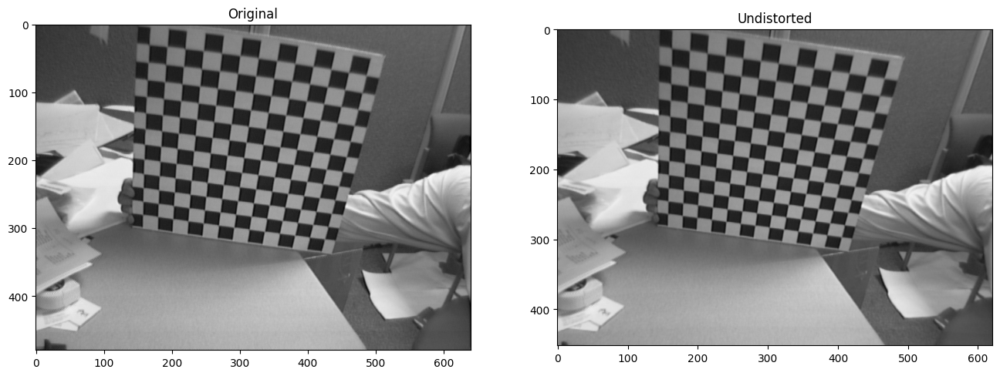

In [9]:
for image_name in images:
    visualize_undistortion(image_name, K, dist_coeffs)

# Structure From Motion

Input: Casual Videos and Images (2D correspondences)

Output: Camera pose + 3D scene (point cloud)

## Configuration

In [10]:
class Config:
    def __init__(self):
        self.image_dir = os.path.join(base_path, 'images') + '//'
        self.MRT = 0.7
        self.K = np.array([
            [2362.12, 0, 720],
            [0, 2362.12, 578],
            [0, 0, 1]
        ])
        self.x = 0.5
        self.y = 1

config = Config()

print("MRT:", config.MRT)
print("\n카메라 내부 파라미터 행렬 K:")
print(config.K)
print("\n선택적으로 선택한 지점을 제거하는 범위 x:", config.x)
print("선택적으로 선택한 지점을 제거하는 범위 y:", config.y)

MRT: 0.7

카메라 내부 파라미터 행렬 K:
[[2.36212e+03 0.00000e+00 7.20000e+02]
 [0.00000e+00 2.36212e+03 5.78000e+02]
 [0.00000e+00 0.00000e+00 1.00000e+00]]

선택적으로 선택한 지점을 제거하는 범위 x: 0.5
선택적으로 선택한 지점을 제거하는 범위 y: 1


## 두 이미지 간의 특징 추출 및 매칭


### Feature Extraction을 위해 함수의 빈칸을 채워주세요 (10분)

In [11]:
def extract_features(image_names):

    #######################################################################
    # CODE HERE
    ## initialize SIFT
    ## Function
    ### cv2.xfeatures2d.SIFT_create
    ### 0, 3, 0.04, 10
    sift = cv2.xfeatures2d.SIFT_create(0, 3, 0.04, 10)
    #######################################################################

    key_points_for_all = []
    descriptor_for_all = []
    colors_for_all = []
    for image_name in image_names:
        image = cv2.imread(image_name)

        if image is None:
            continue

        #######################################################################
        # CODE HERE
        ## initialize SIFT
        ## Function
        ### sift.detectAndCompute
        key_points, descriptor = sift.detectAndCompute(cv2.cvtColor(image, cv2.COLOR_BGR2GRAY), None)
        #######################################################################

        if len(key_points) <= 10:
            continue

        key_points_for_all.append(key_points)
        descriptor_for_all.append(descriptor)
        colors = np.zeros((len(key_points), 3))
        for i, key_point in enumerate(key_points):
            p = key_point.pt
            colors[i] = image[int(p[1])][int(p[0])]
        colors_for_all.append(colors)
    return np.array(key_points_for_all), np.array(descriptor_for_all), np.array(colors_for_all)

def match_features(query, train):
    # Lowe의 SIFT 매칭 비율 테스트(MRT) 적용
    bf = cv2.BFMatcher(cv2.NORM_L2)

    #######################################################################
    # CODE HERE
    ## Function
    ### bf.knnMatch
    knn_matches = bf.knnMatch(query, train, k=2)
    #######################################################################

    matches = []
    for m, n in knn_matches:
        if m.distance < config.MRT * n.distance:
            matches.append(m)

    return np.array(matches)

def match_all_features(descriptor_for_all):
    matches_for_all = []
    for i in range(len(descriptor_for_all) - 1):

        #######################################################################
        # CODE HERE
        ## Function
        ### match_features
        matches = match_features(descriptor_for_all[i], descriptor_for_all[i + 1])
        #######################################################################
        matches_for_all.append(matches)
        
    return np.array(matches_for_all)

## 두 이미지 간의 해당 카메라 회전 각도 및 카메라 평행 이동 찾기

### Essential Matrix를 구하기 위한 함수의 빈칸을 채워주세요 (10분)

In [12]:
def find_transform(K, p1, p2):

    focal_length = 0.5 * (K[0, 0] + K[1, 1])
    principle_point = (K[0, 2], K[1, 2])

    #######################################################################
    # CODE HERE
    ## Function
    ### findEssentialMat
    E, mask = cv2.findEssentialMat(p1, p2, focal=focal_length, pp=principle_point, method=cv2.RANSAC, prob=0.999, threshold=1.0)
    #######################################################################

    cameraMatrix = np.array([[focal_length, 0, principle_point[0]], [0, focal_length, principle_point[1]], [0, 0, 1]])
    pass_count, R, T, mask = cv2.recoverPose(E, p1, p2, cameraMatrix, mask)

    return R, T, mask

def get_matched_points(p1, p2, matches):

    src_pts = np.asarray([p1[m.queryIdx].pt for m in matches])
    dst_pts = np.asarray([p2[m.trainIdx].pt for m in matches])

    return src_pts, dst_pts

def get_matched_colors(c1, c2, matches):

    color_src_pts = np.asarray([c1[m.queryIdx] for m in matches])
    color_dst_pts = np.asarray([c2[m.trainIdx] for m in matches])

    return color_src_pts, color_dst_pts

# 겹치는 점 선택하기
def maskout_points(p1, mask):

    p1_copy = []
    for i in range(len(mask)):
        if mask[i] > 0:
            p1_copy.append(p1[i])

    return np.array(p1_copy)

def init_structure(K, key_points_for_all, colors_for_all, matches_for_all):
    p1, p2 = get_matched_points(key_points_for_all[0], key_points_for_all[1], matches_for_all[0])
    c1, c2 = get_matched_colors(colors_for_all[0], colors_for_all[1], matches_for_all[0])

    if find_transform(K, p1, p2):
        R, T, mask = find_transform(K, p1, p2)
    else:
        R, T, mask = np.array([]), np.array([]), np.array([])

    p1 = maskout_points(p1, mask)
    p2 = maskout_points(p2, mask)
    colors = maskout_points(c1, mask)

    # 첫 번째 카메라의 변환 행렬 설정, 이는 나머지 카메라 행렬 변환의 기준이 됨.
    R0 = np.eye(3, 3)
    T0 = np.zeros((3, 1))
    structure = reconstruct(K, R0, T0, R, T, p1, p2)
    rotations = [R0, R]
    motions = [T0, T]
    correspond_struct_idx = []
    for key_p in key_points_for_all:
        correspond_struct_idx.append(np.ones(len(key_p)) *- 1)
    correspond_struct_idx = np.array(correspond_struct_idx)
    idx = 0
    matches = matches_for_all[0]
    for i, match in enumerate(matches):
        if mask[i] == 0:
            continue
        correspond_struct_idx[0][int(match.queryIdx)] = idx
        correspond_struct_idx[1][int(match.trainIdx)] = idx
        idx += 1
    return structure, correspond_struct_idx, colors, rotations, motions

## 3D reconstruction (Triangulation)

Given calibrated multiview cameras, reconstructing 3D points

### triangulation 함수를 완성해주세요 (5분)

In [13]:
def reconstruct(K, R1, T1, R2, T2, p1, p2):

    proj1 = np.zeros((3, 4))
    proj2 = np.zeros((3, 4))
    proj1[0:3, 0:3] = np.float32(R1)
    proj1[:, 3] = np.float32(T1.T)
    proj2[0:3, 0:3] = np.float32(R2)
    proj2[:, 3] = np.float32(T2.T)
    fk = np.float32(K)
    proj1 = np.dot(fk, proj1)
    proj2 = np.dot(fk, proj2)

    #######################################################################
    # CODE HERE
    ## Function
    ### cv2.triangulatePoints
    s = cv2.triangulatePoints(proj1, proj2, p1.T, p2.T)
    #######################################################################

    structure = []

    for i in range(len(s[0])):
        col = s[:, i]
        col /= col[3]
        structure.append([col[0], col[1], col[2]])

    return np.array(structure)

## Merge Point Cloud

In [14]:
def fusion_structure(matches, struct_indices, next_struct_indices, structure, next_structure, colors, next_colors):

    for i,match in enumerate(matches):
        query_idx = match.queryIdx
        train_idx = match.trainIdx
        struct_idx = struct_indices[query_idx]
        if struct_idx >= 0:
            next_struct_indices[train_idx] = struct_idx
            continue
        structure = np.append(structure, [next_structure[i]], axis = 0)
        colors = np.append(colors, [next_colors[i]], axis = 0)
        struct_indices[query_idx] = next_struct_indices[train_idx] = len(structure) - 1
    return struct_indices, next_struct_indices, structure, colors

def get_objpoints_and_imgpoints(matches, struct_indices, structure, key_points):

    object_points = []
    image_points = []
    for match in matches:
        query_idx = match.queryIdx
        train_idx = match.trainIdx
        struct_idx = struct_indices[query_idx]
        if struct_idx < 0:
            continue
        object_points.append(structure[int(struct_idx)])
        image_points.append(key_points[train_idx].pt)

    return np.array(object_points), np.array(image_points)

## bundle adjustment

### Point projection을 구현해주세요 (5분)

In [15]:
def get_3dpos(pos, ob, r, t, K):
    dtype = np.float32
    def F(x):
        #######################################################################
        # CODE HERE
        ## Function
        ## cv2.projectPoints
        p, J = cv2.projectPoints(pos.reshape(1, 1, 3), r, t, K, np.array([]))
        #######################################################################

        p = p.reshape(2)
        e = ob - p
        err = e

        return err
    res = least_squares(F, pos)
    return res.x

def get_3dpos_v1(pos,ob,r,t,K):
    #######################################################################
    # CODE HERE
    ## Function
    ## cv2.projectPoints
    p, J = cv2.projectPoints(pos.reshape(1, 1, 3), r, t, K, np.array([]))
    #######################################################################

    p = p.reshape(2)
    e = ob - p
    if abs(e[0]) > config.x or abs(e[1]) > config.y:
        return None
    return pos

def bundle_adjustment(rotations, motions, K, correspond_struct_idx, key_points_for_all, structure):
    for i in range(len(rotations)):
        r, _ = cv2.Rodrigues(rotations[i])
        rotations[i] = r

    for i in range(len(correspond_struct_idx)):
        point3d_ids = correspond_struct_idx[i]
        key_points = key_points_for_all[i]
        r = rotations[i]
        t = motions[i]
        for j in range(len(point3d_ids)):
            point3d_id = int(point3d_ids[j])
            if point3d_id < 0:
                continue

            #######################################################################
            # CODE HERE
            ## Function
            ## get_3dpos_v1
            new_point = get_3dpos_v1(structure[point3d_id], key_points[j].pt, r, t, K)
            #######################################################################
            structure[point3d_id] = new_point

    return structure

## Visualization

In [16]:
def fig(structure, colors):
    colors = colors / 255.0  # Normalize colors to [0, 1] range
    for i in range(len(colors)):
        colors[i, :] = colors[i, :][[2, 1, 0]]  # Swap RGB to BGR if necessary

    # Create a 3D scatter plot using Plotly
    fig = go.Figure()

    for i in range(len(structure)):
        fig.add_trace(go.Scatter3d(
            x=[structure[i, 0]],
            y=[structure[i, 1]],
            z=[structure[i, 2]],
            mode='markers',
            marker=dict(
                size=5,
                color='rgb({}, {}, {})'.format(colors[i, 0]*255, colors[i, 1]*255, colors[i, 2]*255)  # Convert colors back to 0-255 range
            )
        ))

    fig.update_layout(
        title='3D Scatter Plot',
        scene=dict(
            xaxis_title='X Axis',
            yaxis_title='Y Axis',
            zaxis_title='Z Axis'
        ),
        scene_camera=dict(
            eye=dict(x=0.5, y=1.3, z=0.5)
        )
    )

    fig.show()

In [17]:
imgdir = config.image_dir
img_names = os.listdir(imgdir)
img_names = natsort.natsorted(img_names)

for i in range(len(img_names)):
    img_names[i] = imgdir + img_names[i]

K = config.K

In [18]:
key_points_for_all, descriptor_for_all, colors_for_all = extract_features(img_names)
matches_for_all = match_all_features(descriptor_for_all)
structure, correspond_struct_idx, colors, rotations, motions = init_structure(K, key_points_for_all, colors_for_all, matches_for_all)

[ WARN:0@130.847] global shadow_sift.hpp:13 SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736
/tmp/ipykernel_750395/923526446.py:39: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(key_points_for_all), np.array(descriptor_for_all), np.array(colors_for_all)
/tmp/ipykernel_750395/923526446.py:71: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(matches_for_all)
/tmp/ipykernel_750395/80995014.py:64: VisibleDeprecationWarning

### PnP함수를 작성해주세요 (5분)

In [19]:
for i in range(1, len(matches_for_all)):
    object_points, image_points = get_objpoints_and_imgpoints(matches_for_all[i], correspond_struct_idx[i], structure, key_points_for_all[i + 1])
    # Python의 OpenCV에서 solvePnPRansac 함수의 첫 번째 파라미터의 길이는 7보다 길어야함
    # 7개보다 작은 점 집합에 대해서는 점 집합의 첫 번째 점을 반복해서 채워 7개로 만듦.
    if len(image_points) < 7:
        while len(image_points) < 7:
            object_points = np.append(object_points, [object_points[0]], axis = 0)
            image_points = np.append(image_points, [image_points[0]], axis = 0)

    #######################################################################
    # CODE HERE
    ## Function
    ### solvePnPRansac
    _, r, T, _ = cv2.solvePnPRansac(object_points, image_points, K, np.array([]))
    #######################################################################

    R, _ = cv2.Rodrigues(r)
    rotations.append(R)
    motions.append(T)
    p1, p2 = get_matched_points(key_points_for_all[i], key_points_for_all[i + 1], matches_for_all[i])
    c1, c2 = get_matched_colors(colors_for_all[i], colors_for_all[i + 1], matches_for_all[i])
    next_structure = reconstruct(K, rotations[i], motions[i], R, T, p1, p2)

    correspond_struct_idx[i], correspond_struct_idx[i + 1], structure, colors = fusion_structure(matches_for_all[i],correspond_struct_idx[i],correspond_struct_idx[i+1],structure,next_structure,colors,c1)

In [20]:
structure = bundle_adjustment(rotations, motions, K, correspond_struct_idx, key_points_for_all, structure)

In [25]:
# bundle adjustment을 거친 구조에는 빈 점들이 생길 수 있음 (실제로는 삭제된 것을 의미)
# 여기서는 그 빈 점들을 삭제.

i = 0
while i < len(structure):
    if math.isnan(structure[i][0]):
        structure = np.delete(structure, i, 0)
        colors = np.delete(colors, i, 0)
        i -= 1
    i += 1

print(len(structure))
print(len(motions))

497
6


In [26]:
fig(structure, colors)

## Reference
Based on this code: https://zhuanlan.zhihu.com/p/30033898

Images: https://github.com/openMVG/SfM_quality_evaluation

# NeRF (Neural Radiance Fields)

### Introduction

This notebook walks the reader through a full implementation of the original Neural Radiance Field architecture, first introduced by Mildenhall et al. in "[NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis.](https://www.matthewtancik.com/nerf)" For a broader overview, read the accompanying Medium article "[It's NeRF From Nothing: Build A Complete NeRF With Pytorch.](https://medium.com/@masonmcgough/its-nerf-from-nothing-build-a-vanilla-nerf-with-pytorch-7846e4c45666)" This notebook assumes that you have read that article and understand the basics of NeRF.

Much of the code comes from or is inspired by the original implementation by GitHub user [bmild](https://github.com/bmild/nerf) as well as PyTorch implementations from GitHub users [yenchenlin](https://github.com/bmild/nerf) and [krrish94](https://github.com/krrish94/nerf-pytorch/). The code has been modified for clarity and consistency.




#### Imports

In [86]:
# For repeatability
seed = 3407
torch.manual_seed(seed)
np.random.seed(seed)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

### Inputs

#### Data

First we load the data which we will train our NeRF model on. This is the Lego bulldozer commonly seen in the NeRF demonstrations and serves as a sort of "Hello World" for training NeRFs. Covering other datasets is outside the scope of this notebook, but feel free to try others included in the original [NeRF source code](https://github.com/bmild/nerf) or your own datasets.

In [27]:
if not os.path.exists('tiny_nerf_data.npz'):
  !wget http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz

--2024-08-06 17:23:57--  http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Resolving cseweb.ucsd.edu (cseweb.ucsd.edu)... 132.239.8.30
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz [following]
--2024-08-06 17:23:58--  https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12727482 (12M)
Saving to: ‘tiny_nerf_data.npz’

tiny_nerf_data.npz  100%[===================>]  12.14M  5.42MB/s    in 2.2s    

2024-08-06 17:24:02 (5.42 MB/s) - ‘tiny_nerf_data.npz’ saved [12727482/12727482]



This dataset consists of 106 images taken of the synthetic Lego bulldozer along with poses and a common focal length value. Like the original, we reserve the first 100 images for training and a single test image for validation.

Images shape: (106, 100, 100, 3)
Poses shape: (106, 4, 4)
Focal length: 138.88887889922103
Pose
[[ 6.8935126e-01  5.3373039e-01 -4.8982298e-01 -1.9745398e+00]
 [-7.2442728e-01  5.0788772e-01 -4.6610624e-01 -1.8789345e+00]
 [ 1.4901163e-08  6.7615211e-01  7.3676193e-01  2.9699826e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]


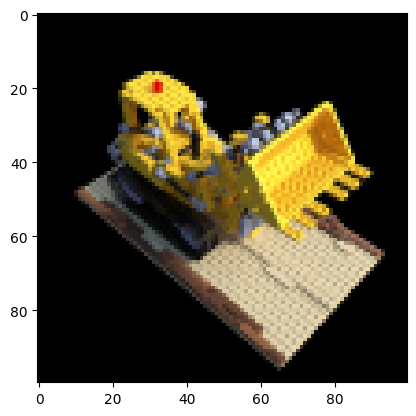

In [88]:
data = np.load('tiny_nerf_data.npz')
images = data['images']
poses = data['poses']
focal = data['focal']

print(f'Images shape: {images.shape}')
print(f'Poses shape: {poses.shape}')
print(f'Focal length: {focal}')

height, width = images.shape[1:3]
near, far = 2., 6.

n_training = 100
testimg_idx = 101
testimg, testpose = images[testimg_idx], poses[testimg_idx]

plt.imshow(testimg)
print('Pose')
print(testpose)

#### Origins and Directions

Recall that NeRF processes inputs from a field of positions (x,y,z) and view directions (θ,φ). To gather these input points, we need to apply inverse rendering to the input images. More concretely, we draw projection lines through each pixel and across the 3D space, from which we can draw samples.

To sample points from the 3D space beyond our image, we first start from the initial pose of every camera taken in the photo set. With some vector math, we can convert these 4x4 pose matrices into a 3D coordinate denoting the origin and a 3D vector indicating the direction. The two together describe a vector that indicates where a camera was pointing when the photo was taken.

The code in the cell below illustrates this by drawing arrows that depict the origin and the direction of every frame.

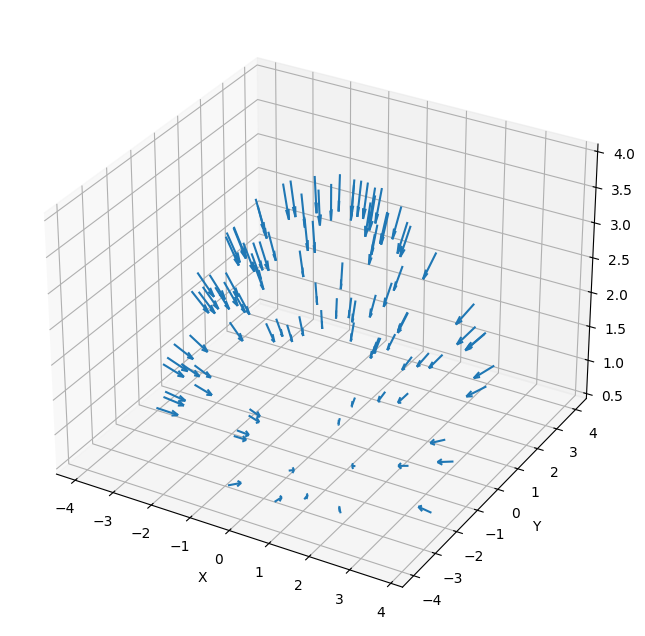

In [89]:
dirs = np.stack([np.sum([0, 0, -1] * pose[:3, :3], axis=-1) for pose in poses])
origins = poses[:, :3, -1]

ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
_ = ax.quiver(
  origins[..., 0].flatten(),
  origins[..., 1].flatten(),
  origins[..., 2].flatten(),
  dirs[..., 0].flatten(),
  dirs[..., 1].flatten(),
  dirs[..., 2].flatten(), length=0.5, normalize=True)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('z')
plt.show()

With this camera pose, we can now find the projection lines along each pixel of our image. Each line is defined by its origin point (x,y,z) and its direction (in this case a 3D vector). While the origin is the same for every pixel, the direction is slightly different. These lines are slightly deflected off center such that none of these lines are parallel.

![Pinhole camera](https://www.researchgate.net/profile/Willy-Azarcoya-Cabiedes/publication/317498100/figure/fig10/AS:610418494013440@1522546518034/Pin-hole-camera-model-terminology-The-optical-center-pinhole-is-placed-at-the-origin.png)

From [Willy Azarcoya-Cabiedes via ResearchGate](https://www.researchgate.net/figure/Pin-hole-camera-model-terminology-The-optical-center-pinhole-is-placed-at-the-origin_fig10_317498100)

In [90]:
def get_rays(
  height: int,
  width: int,
  focal_length: float,
  c2w: torch.Tensor
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Find origin and direction of rays through every pixel and camera origin.
  """

  # Apply pinhole camera model to gather directions at each pixel
  i, j = torch.meshgrid(
      torch.arange(width, dtype=torch.float32).to(c2w),
      torch.arange(height, dtype=torch.float32).to(c2w),
      indexing='ij')
  i, j = i.transpose(-1, -2), j.transpose(-1, -2)
  directions = torch.stack([(i - width * .5) / focal_length,
                            -(j - height * .5) / focal_length,
                            -torch.ones_like(i)
                           ], dim=-1)

  # Apply camera pose to directions
  rays_d = torch.sum(directions[..., None, :] * c2w[:3, :3], dim=-1)

  # Origin is same for all directions (the optical center)
  rays_o = c2w[:3, -1].expand(rays_d.shape)
  return rays_o, rays_d

In [91]:
# Gather as torch tensors
images = torch.from_numpy(data['images'][:n_training]).to(device)
poses = torch.from_numpy(data['poses']).to(device)
focal = torch.from_numpy(data['focal']).to(device)
testimg = torch.from_numpy(data['images'][testimg_idx]).to(device)
testpose = torch.from_numpy(data['poses'][testimg_idx]).to(device)

# Grab rays from sample image
height, width = images.shape[1:3]
with torch.no_grad():
  ray_origin, ray_direction = get_rays(height, width, focal, testpose)

print('Ray Origin')
print(ray_origin.shape)
print(ray_origin[height // 2, width // 2, :])
print('')

print('Ray Direction')
print(ray_direction.shape)
print(ray_direction[height // 2, width // 2, :])
print('')

Ray Origin
torch.Size([100, 100, 3])
tensor([-1.9745, -1.8789,  2.9700], device='cuda:0')

Ray Direction
torch.Size([100, 100, 3])
tensor([ 0.4898,  0.4661, -0.7368], device='cuda:0')



### Architecture

#### Stratified Sampling

Now that we have these lines, defined as origin and direction vectors, we can begin the process of sampling them. Recall that NeRF takes a coarse-to-fine sampling strategy, starting with the stratified sampling approach.

The stratified sampling approach splits the ray into evenly-spaced bins and randomly samples within each bin. The `perturb` setting determines whether to sample points uniformly from each bin or to simply use the bin center as the point. In most cases, we want to keep `perturb = True` as it will encourage the network to learn over a continuously sampled space. It may be useful to disable for debugging.

In [92]:
def sample_stratified(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  n_samples: int,
  perturb: Optional[bool] = True,
  inverse_depth: bool = False
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Sample along ray from regularly-spaced bins.
  """

  # Grab samples for space integration along ray
  t_vals = torch.linspace(0., 1., n_samples, device=rays_o.device)
  if not inverse_depth:
    # Sample linearly between `near` and `far`
    z_vals = near * (1.-t_vals) + far * (t_vals)
  else:
    # Sample linearly in inverse depth (disparity)
    z_vals = 1./(1./near * (1.-t_vals) + 1./far * (t_vals))

  # Draw uniform samples from bins along ray
  if perturb:
    mids = .5 * (z_vals[1:] + z_vals[:-1])
    upper = torch.concat([mids, z_vals[-1:]], dim=-1)
    lower = torch.concat([z_vals[:1], mids], dim=-1)
    t_rand = torch.rand([n_samples], device=z_vals.device)
    z_vals = lower + (upper - lower) * t_rand
  z_vals = z_vals.expand(list(rays_o.shape[:-1]) + [n_samples])

  # Apply scale from `rays_d` and offset from `rays_o` to samples
  # pts: (width, height, n_samples, 3)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals[..., :, None]
  return pts, z_vals

In [93]:
# Draw stratified samples from example
rays_o = ray_origin.view([-1, 3])
rays_d = ray_direction.view([-1, 3])
n_samples = 8
perturb = True
inverse_depth = False
with torch.no_grad():
  pts, z_vals = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=perturb, inverse_depth=inverse_depth)

print('Input Points')
print(pts.shape)
print('')
print('Distances Along Ray')
print(z_vals.shape)

Input Points
torch.Size([10000, 8, 3])

Distances Along Ray
torch.Size([10000, 8])


Now we visualize these sampled points. The unperturbed blue points are the bin "centers." The red points are a sampling of perturbed points. Notice how the red points are slightly offset from the blue points above them, but all are constrained between `near` and `far`.

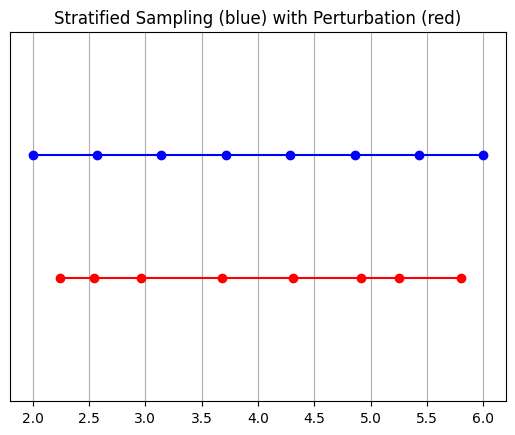

In [94]:
y_vals = torch.zeros_like(z_vals)

_, z_vals_unperturbed = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=False, inverse_depth=inverse_depth)
plt.plot(z_vals_unperturbed[0].cpu().numpy(), 1 + y_vals[0].cpu().numpy(), 'b-o')
plt.plot(z_vals[0].cpu().numpy(), y_vals[0].cpu().numpy(), 'r-o')
plt.ylim([-1, 2])
plt.title('Stratified Sampling (blue) with Perturbation (red)')
ax = plt.gca()
ax.axes.yaxis.set_visible(False)
plt.grid(True)

#### Positional Encoder

Much like Transformers, NeRFs make use of positional encoders. In this case, it's to map the inputs to a higher frequency space to compensate for the bias that neural networks have for learning lower-frequency functions.

Here we build a simple `torch.nn.Module` of our positional encoder. The same encoder implementation can be applied to both input samples and view directions. However, we choose different parameters for these inputs. We use the default settings from the original.

In [95]:
class PositionalEncoder(nn.Module):
  r"""
  Sine-cosine positional encoder for input points.
  """
  def __init__(
    self,
    d_input: int,
    n_freqs: int,
    log_space: bool = False
  ):
    super().__init__()
    self.d_input = d_input
    self.n_freqs = n_freqs
    self.log_space = log_space
    self.d_output = d_input * (1 + 2 * self.n_freqs)
    self.embed_fns = [lambda x: x]

    # Define frequencies in either linear or log scale
    if self.log_space:
      freq_bands = 2.**torch.linspace(0., self.n_freqs - 1, self.n_freqs)
    else:
      freq_bands = torch.linspace(2.**0., 2.**(self.n_freqs - 1), self.n_freqs)

    # Alternate sin and cos
    for freq in freq_bands:
      self.embed_fns.append(lambda x , freq=freq: torch.sin(x * freq))
      self.embed_fns.append(lambda x, freq=freq: torch.cos(x * freq))

  def forward(
    self,
    x
  ) -> torch.Tensor:
    r"""
    Apply positional encoding to input.
    """
    return torch.concat([fn(x) for fn in self.embed_fns], dim=-1)


In [96]:
# Create encoders for points and view directions
encoder = PositionalEncoder(3, 10)
viewdirs_encoder = PositionalEncoder(3, 4)

# Grab flattened points and view directions
pts_flattened = pts.reshape(-1, 3)
viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
flattened_viewdirs = viewdirs[:, None, ...].expand(pts.shape).reshape((-1, 3))

# Encode inputs
encoded_points = encoder(pts_flattened)
encoded_viewdirs = viewdirs_encoder(flattened_viewdirs)

print('Encoded Points')
print(encoded_points.shape)
print(torch.min(encoded_points), torch.max(encoded_points), torch.mean(encoded_points))
print('')

print(encoded_viewdirs.shape)
print('Encoded Viewdirs')
print(torch.min(encoded_viewdirs), torch.max(encoded_viewdirs), torch.mean(encoded_viewdirs))
print('')

Encoded Points
torch.Size([80000, 63])
tensor(-2.6900, device='cuda:0') tensor(3.4005, device='cuda:0') tensor(0.0273, device='cuda:0')

torch.Size([80000, 27])
Encoded Viewdirs
tensor(-1., device='cuda:0') tensor(1., device='cuda:0') tensor(0.1056, device='cuda:0')



#### NeRF Model

Here we define the NeRF model, which consists primarily of a `ModuleList` of `Linear` layers, separated by non-linear activation functions and the occasional residual connection. This model features an optional input for view directions, which will alter the model architecture if provided at instantiation. This implementation is based on Section 3 of the original "NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis" paper and uses the same defaults.

In [97]:
class NeRF(nn.Module):
  r"""
  Neural radiance fields module.
  """
  def __init__(
    self,
    d_input: int = 3,
    n_layers: int = 8,
    d_filter: int = 256,
    skip: Tuple[int] = (4,),
    d_viewdirs: Optional[int] = None
  ):
    super().__init__()
    self.d_input = d_input
    self.skip = skip
    self.act = nn.functional.relu
    self.d_viewdirs = d_viewdirs

    # Create model layers
    self.layers = nn.ModuleList(
      [nn.Linear(self.d_input, d_filter)] +
      [nn.Linear(d_filter + self.d_input, d_filter) if i in skip \
       else nn.Linear(d_filter, d_filter) for i in range(n_layers - 1)]
    )

    # Bottleneck layers
    if self.d_viewdirs is not None:
      # If using viewdirs, split alpha and RGB
      self.alpha_out = nn.Linear(d_filter, 1)
      self.rgb_filters = nn.Linear(d_filter, d_filter)
      self.branch = nn.Linear(d_filter + self.d_viewdirs, d_filter // 2)
      self.output = nn.Linear(d_filter // 2, 3)
    else:
      # If no viewdirs, use simpler output
      self.output = nn.Linear(d_filter, 4)

  def forward(
    self,
    x: torch.Tensor,
    viewdirs: Optional[torch.Tensor] = None
  ) -> torch.Tensor:
    r"""
    Forward pass with optional view direction.
    """

    # Cannot use viewdirs if instantiated with d_viewdirs = None
    if self.d_viewdirs is None and viewdirs is not None:
      raise ValueError('Cannot input x_direction if d_viewdirs was not given.')

    # Apply forward pass up to bottleneck
    x_input = x
    for i, layer in enumerate(self.layers):
      x = self.act(layer(x))
      if i in self.skip:
        x = torch.cat([x, x_input], dim=-1)

    # Apply bottleneck
    if self.d_viewdirs is not None:
      # Split alpha from network output
      alpha = self.alpha_out(x)

      # Pass through bottleneck to get RGB
      x = self.rgb_filters(x)
      x = torch.concat([x, viewdirs], dim=-1)
      x = self.act(self.branch(x))
      x = self.output(x)

      # Concatenate alphas to output
      x = torch.concat([x, alpha], dim=-1)
    else:
      # Simple output
      x = self.output(x)
    return x

#### Volume Rendering

From the raw NeRF outputs, we still need to convert these into an image. This is where we apply the volume integration described in Equations 1-3 in Section 4 of the paper. Essentially, we take the weighted sum of all samples along the ray of each pixel to get the estimated color value at that pixel. Each RGB sample is weighted by its alpha value. Higher alpha values indicate higher likelihood that the sampled area is opaque, therefore points further along the ray are likelier to be occluded. The cumulative product ensures that those further points are dampened.

In [98]:
def cumprod_exclusive(
  tensor: torch.Tensor
) -> torch.Tensor:
  r"""
  (Courtesy of https://github.com/krrish94/nerf-pytorch)

  Mimick functionality of tf.math.cumprod(..., exclusive=True), as it isn't available in PyTorch.

  Args:
  tensor (torch.Tensor): Tensor whose cumprod (cumulative product, see `torch.cumprod`) along dim=-1
    is to be computed.
  Returns:
  cumprod (torch.Tensor): cumprod of Tensor along dim=-1, mimiciking the functionality of
    tf.math.cumprod(..., exclusive=True) (see `tf.math.cumprod` for details).
  """

  # Compute regular cumprod first (this is equivalent to `tf.math.cumprod(..., exclusive=False)`).
  cumprod = torch.cumprod(tensor, -1)
  # "Roll" the elements along dimension 'dim' by 1 element.
  cumprod = torch.roll(cumprod, 1, -1)
  # Replace the first element by "1" as this is what tf.cumprod(..., exclusive=True) does.
  cumprod[..., 0] = 1.

  return cumprod

def raw2outputs(
  raw: torch.Tensor,
  z_vals: torch.Tensor,
  rays_d: torch.Tensor,
  raw_noise_std: float = 0.0,
  white_bkgd: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Convert the raw NeRF output into RGB and other maps.
  """

  # Difference between consecutive elements of `z_vals`. [n_rays, n_samples]
  dists = z_vals[..., 1:] - z_vals[..., :-1]
  dists = torch.cat([dists, 1e10 * torch.ones_like(dists[..., :1])], dim=-1)

  # Multiply each distance by the norm of its corresponding direction ray
  # to convert to real world distance (accounts for non-unit directions).
  dists = dists * torch.norm(rays_d[..., None, :], dim=-1)

  # Add noise to model's predictions for density. Can be used to
  # regularize network during training (prevents floater artifacts).
  noise = 0.
  if raw_noise_std > 0.:
    noise = torch.randn(raw[..., 3].shape) * raw_noise_std

  # Predict density of each sample along each ray. Higher values imply
  # higher likelihood of being absorbed at this point. [n_rays, n_samples]
  alpha = 1.0 - torch.exp(-nn.functional.relu(raw[..., 3] + noise) * dists)

  # Compute weight for RGB of each sample along each ray. [n_rays, n_samples]
  # The higher the alpha, the lower subsequent weights are driven.
  weights = alpha * cumprod_exclusive(1. - alpha + 1e-10)

  # Compute weighted RGB map.
  rgb = torch.sigmoid(raw[..., :3])  # [n_rays, n_samples, 3]
  rgb_map = torch.sum(weights[..., None] * rgb, dim=-2)  # [n_rays, 3]

  # Estimated depth map is predicted distance.
  depth_map = torch.sum(weights * z_vals, dim=-1)

  # # Disparity map is inverse depth.
  # disp_map = 1. / torch.max(1e-10 * torch.ones_like(depth_map),
  #                           depth_map / torch.sum(weights, -1))

  # Sum of weights along each ray. In [0, 1] up to numerical error.
  acc_map = torch.sum(weights, dim=-1)

  # To composite onto a white background, use the accumulated alpha map.
  if white_bkgd:
    rgb_map = rgb_map + (1. - acc_map[..., None])

  return rgb_map, depth_map, acc_map, weights

#### Hierarchical Volume Sampling

The 3D space is in fact very sparse with occlusions and so most points don't contribute much to the rendered image. It is therefore more beneficial to oversample regions with a high likelihood of contributing to the integral. Here we apply learned, normalized weights to the first set of samples to create a PDF across the ray, then apply inverse transform sampling to this PDF to gather a second set of samples.

In [99]:
def sample_pdf(
  bins: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> torch.Tensor:
  r"""
  Apply inverse transform sampling to a weighted set of points.
  """

  # Normalize weights to get PDF.
  pdf = (weights + 1e-5) / torch.sum(weights + 1e-5, -1, keepdims=True) # [n_rays, weights.shape[-1]]

  # Convert PDF to CDF.
  cdf = torch.cumsum(pdf, dim=-1) # [n_rays, weights.shape[-1]]
  cdf = torch.concat([torch.zeros_like(cdf[..., :1]), cdf], dim=-1) # [n_rays, weights.shape[-1] + 1]

  # Take sample positions to grab from CDF. Linear when perturb == 0.
  if not perturb:
    u = torch.linspace(0., 1., n_samples, device=cdf.device)
    u = u.expand(list(cdf.shape[:-1]) + [n_samples]) # [n_rays, n_samples]
  else:
    u = torch.rand(list(cdf.shape[:-1]) + [n_samples], device=cdf.device) # [n_rays, n_samples]

  # Find indices along CDF where values in u would be placed.
  u = u.contiguous() # Returns contiguous tensor with same values.
  inds = torch.searchsorted(cdf, u, right=True) # [n_rays, n_samples]

  # Clamp indices that are out of bounds.
  below = torch.clamp(inds - 1, min=0)
  above = torch.clamp(inds, max=cdf.shape[-1] - 1)
  inds_g = torch.stack([below, above], dim=-1) # [n_rays, n_samples, 2]

  # Sample from cdf and the corresponding bin centers.
  matched_shape = list(inds_g.shape[:-1]) + [cdf.shape[-1]]
  cdf_g = torch.gather(cdf.unsqueeze(-2).expand(matched_shape), dim=-1,
                       index=inds_g)
  bins_g = torch.gather(bins.unsqueeze(-2).expand(matched_shape), dim=-1,
                        index=inds_g)

  # Convert samples to ray length.
  denom = (cdf_g[..., 1] - cdf_g[..., 0])
  denom = torch.where(denom < 1e-5, torch.ones_like(denom), denom)
  t = (u - cdf_g[..., 0]) / denom
  samples = bins_g[..., 0] + t * (bins_g[..., 1] - bins_g[..., 0])

  return samples # [n_rays, n_samples]

In [100]:
def sample_hierarchical(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  z_vals: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Apply hierarchical sampling to the rays.
  """

  # Draw samples from PDF using z_vals as bins and weights as probabilities.
  z_vals_mid = .5 * (z_vals[..., 1:] + z_vals[..., :-1])
  new_z_samples = sample_pdf(z_vals_mid, weights[..., 1:-1], n_samples,
                          perturb=perturb)
  new_z_samples = new_z_samples.detach()

  # Resample points from ray based on PDF.
  z_vals_combined, _ = torch.sort(torch.cat([z_vals, new_z_samples], dim=-1), dim=-1)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals_combined[..., :, None]  # [N_rays, N_samples + n_samples, 3]
  return pts, z_vals_combined, new_z_samples

#### Full Forward Pass

Here is where we put everything together to compute a single forward pass through our model.

Due to potential memory issues, the forward pass is computed in "chunks," which are then aggregated across a single batch. The gradient propagation is done after the whole batch is processed, hence the distinction between "chunks" and "batches." Chunking is especially important for the Google Colab environment, which provides more modest resources than those cited in the original paper.

In [102]:
def get_chunks(
  inputs: torch.Tensor,
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Divide an input into chunks.
  """
  return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

def prepare_chunks(
  points: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify points to prepare for NeRF model.
  """
  points = points.reshape((-1, 3))
  points = encoding_function(points)
  points = get_chunks(points, chunksize=chunksize)
  return points

def prepare_viewdirs_chunks(
  points: torch.Tensor,
  rays_d: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify viewdirs to prepare for NeRF model.
  """
  # Prepare the viewdirs
  viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
  viewdirs = viewdirs[:, None, ...].expand(points.shape).reshape((-1, 3))
  viewdirs = encoding_function(viewdirs)
  viewdirs = get_chunks(viewdirs, chunksize=chunksize)
  return viewdirs

In [103]:
def nerf_forward(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  encoding_fn: Callable[[torch.Tensor], torch.Tensor],
  coarse_model: nn.Module,
  kwargs_sample_stratified: dict = None,
  n_samples_hierarchical: int = 0,
  kwargs_sample_hierarchical: dict = None,
  fine_model = None,
  viewdirs_encoding_fn: Optional[Callable[[torch.Tensor], torch.Tensor]] = None,
  chunksize: int = 2**15
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, dict]:
  r"""
  Compute forward pass through model(s).
  """

  # Set no kwargs if none are given.
  if kwargs_sample_stratified is None:
    kwargs_sample_stratified = {}
  if kwargs_sample_hierarchical is None:
    kwargs_sample_hierarchical = {}

  # Sample query points along each ray.
  query_points, z_vals = sample_stratified(
      rays_o, rays_d, near, far, **kwargs_sample_stratified)

  # Prepare batches.
  batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
  if viewdirs_encoding_fn is not None:
    batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                               viewdirs_encoding_fn,
                                               chunksize=chunksize)
  else:
    batches_viewdirs = [None] * len(batches)

  # Coarse model pass.
  # Split the encoded points into "chunks", run the model on all chunks, and
  # concatenate the results (to avoid out-of-memory issues).
  predictions = []
  for batch, batch_viewdirs in zip(batches, batches_viewdirs):
    predictions.append(coarse_model(batch, viewdirs=batch_viewdirs))
  raw = torch.cat(predictions, dim=0)
  raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

  # Perform differentiable volume rendering to re-synthesize the RGB image.
  rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals, rays_d)
  # rgb_map, depth_map, acc_map, weights = render_volume_density(raw, rays_o, z_vals)
  outputs = {
      'z_vals_stratified': z_vals
  }

  # Fine model pass.
  if n_samples_hierarchical > 0:
    # Save previous outputs to return.
    rgb_map_0, depth_map_0, acc_map_0 = rgb_map, depth_map, acc_map

    # Apply hierarchical sampling for fine query points.
    query_points, z_vals_combined, z_hierarch = sample_hierarchical(
      rays_o, rays_d, z_vals, weights, n_samples_hierarchical,
      **kwargs_sample_hierarchical)

    # Prepare inputs as before.
    batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
    if viewdirs_encoding_fn is not None:
      batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                                 viewdirs_encoding_fn,
                                                 chunksize=chunksize)
    else:
      batches_viewdirs = [None] * len(batches)

    # Forward pass new samples through fine model.
    fine_model = fine_model if fine_model is not None else coarse_model
    predictions = []
    for batch, batch_viewdirs in zip(batches, batches_viewdirs):
      predictions.append(fine_model(batch, viewdirs=batch_viewdirs))
    raw = torch.cat(predictions, dim=0)
    raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

    # Perform differentiable volume rendering to re-synthesize the RGB image.
    rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals_combined, rays_d)

    # Store outputs.
    outputs['z_vals_hierarchical'] = z_hierarch
    outputs['rgb_map_0'] = rgb_map_0
    outputs['depth_map_0'] = depth_map_0
    outputs['acc_map_0'] = acc_map_0

  # Store outputs.
  outputs['rgb_map'] = rgb_map
  outputs['depth_map'] = depth_map
  outputs['acc_map'] = acc_map
  outputs['weights'] = weights
  return outputs

### Train

At long last, we have (almost) everything we need to train the model. Now we will do some setup for a simple training procedure, creating hyperparameters and helper functions, then train our model.

#### Hyperparameters

All hyperparameters for training are set here. Defaults were taken from the original, unless computational constraints prohibit them. In this case, we apply sensible defaults that are well within the resources provided by Google Colab.

In [104]:
# Encoders
d_input = 3           # Number of input dimensions
n_freqs = 10          # Number of encoding functions for samples
log_space = True      # If set, frequencies scale in log space
use_viewdirs = True   # If set, use view direction as input
n_freqs_views = 4     # Number of encoding functions for views

# Stratified sampling
n_samples = 64         # Number of spatial samples per ray
perturb = True         # If set, applies noise to sample positions
inverse_depth = False  # If set, samples points linearly in inverse depth

# Model
d_filter = 128          # Dimensions of linear layer filters
n_layers = 2            # Number of layers in network bottleneck
skip = []               # Layers at which to apply input residual
use_fine_model = True   # If set, creates a fine model
d_filter_fine = 128     # Dimensions of linear layer filters of fine network
n_layers_fine = 6       # Number of layers in fine network bottleneck

# Hierarchical sampling
n_samples_hierarchical = 64   # Number of samples per ray
perturb_hierarchical = False  # If set, applies noise to sample positions

# Optimizer
lr = 5e-4  # Learning rate

# Training
n_iters = 10000
batch_size = 2**14          # Number of rays per gradient step (power of 2)
one_image_per_step = True   # One image per gradient step (disables batching)
chunksize = 2**14           # Modify as needed to fit in GPU memory
center_crop = True          # Crop the center of image (one_image_per_)
center_crop_iters = 50      # Stop cropping center after this many epochs
display_rate = 100          # Display test output every X epochs

# Early Stopping
warmup_iters = 200          # Number of iterations during warmup phase
warmup_min_fitness = 8.0   # Min val PSNR to continue training at warmup_iters
n_restarts = 10             # Number of times to restart if training stalls

# We bundle the kwargs for various functions to pass all at once.
kwargs_sample_stratified = {
    'n_samples': n_samples,
    'perturb': perturb,
    'inverse_depth': inverse_depth
}
kwargs_sample_hierarchical = {
    'perturb': perturb
}

#### Training Classes and Functions

Here we create some helper functions for training. NeRF can be prone to local minima, in which training will quickly stall and produce blank outputs. `EarlyStopping` is used to restart the training when learning stalls, if necessary.

In [105]:
def plot_samples(
  z_vals: torch.Tensor,
  z_hierarch: Optional[torch.Tensor] = None,
  ax: Optional[np.ndarray] = None):
  r"""
  Plot stratified and (optional) hierarchical samples.
  """
  y_vals = 1 + np.zeros_like(z_vals)

  if ax is None:
    ax = plt.subplot()
  ax.plot(z_vals, y_vals, 'b-o')
  if z_hierarch is not None:
    y_hierarch = np.zeros_like(z_hierarch)
    ax.plot(z_hierarch, y_hierarch, 'r-o')
  ax.set_ylim([-1, 2])
  ax.set_title('Stratified  Samples (blue) and Hierarchical Samples (red)')
  ax.axes.yaxis.set_visible(False)
  ax.grid(True)
  return ax

def crop_center(
  img: torch.Tensor,
  frac: float = 0.5
) -> torch.Tensor:
  r"""
  Crop center square from image.
  """
  h_offset = round(img.shape[0] * (frac / 2))
  w_offset = round(img.shape[1] * (frac / 2))
  return img[h_offset:-h_offset, w_offset:-w_offset]

class EarlyStopping:
  r"""
  Early stopping helper based on fitness criterion.
  """
  def __init__(
    self,
    patience: int = 30,
    margin: float = 1e-4
  ):
    self.best_fitness = 0.0  # In our case PSNR
    self.best_iter = 0
    self.margin = margin
    self.patience = patience or float('inf')  # epochs to wait after fitness stops improving to stop

  def __call__(
    self,
    iter: int,
    fitness: float
  ):
    r"""
    Check if criterion for stopping is met.
    """
    if (fitness - self.best_fitness) > self.margin:
      self.best_iter = iter
      self.best_fitness = fitness
    delta = iter - self.best_iter
    stop = delta >= self.patience  # stop training if patience exceeded
    return stop

In [106]:
def init_models():
  r"""
  Initialize models, encoders, and optimizer for NeRF training.
  """
  # Encoders
  encoder = PositionalEncoder(d_input, n_freqs, log_space=log_space)
  encode = lambda x: encoder(x)

  # View direction encoders
  if use_viewdirs:
    encoder_viewdirs = PositionalEncoder(d_input, n_freqs_views,
                                        log_space=log_space)
    encode_viewdirs = lambda x: encoder_viewdirs(x)
    d_viewdirs = encoder_viewdirs.d_output
  else:
    encode_viewdirs = None
    d_viewdirs = None

  # Models
  model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
              d_viewdirs=d_viewdirs)
  model.to(device)
  model_params = list(model.parameters())
  if use_fine_model:
    fine_model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
                      d_viewdirs=d_viewdirs)
    fine_model.to(device)
    model_params = model_params + list(fine_model.parameters())
  else:
    fine_model = None

  # Optimizer
  optimizer = torch.optim.Adam(model_params, lr=lr)

  # Early Stopping
  warmup_stopper = EarlyStopping(patience=50)

  return model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper

#### Training Loop

Here we start training our model.

In [107]:
def train():
  r"""
  Launch training session for NeRF.
  """
  # Shuffle rays across all images.
  if not one_image_per_step:
    height, width = images.shape[1:3]
    all_rays = torch.stack([torch.stack(get_rays(height, width, focal, p), 0)
                        for p in poses[:n_training]], 0)
    rays_rgb = torch.cat([all_rays, images[:, None]], 1)
    rays_rgb = torch.permute(rays_rgb, [0, 2, 3, 1, 4])
    rays_rgb = rays_rgb.reshape([-1, 3, 3])
    rays_rgb = rays_rgb.type(torch.float32)
    rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
    i_batch = 0

  train_psnrs = []
  val_psnrs = []
  iternums = []
  for i in trange(n_iters):
    model.train()

    if one_image_per_step:
      # Randomly pick an image as the target.
      target_img_idx = np.random.randint(images.shape[0])
      target_img = images[target_img_idx].to(device)
      if center_crop and i < center_crop_iters:
        target_img = crop_center(target_img)
      height, width = target_img.shape[:2]
      target_pose = poses[target_img_idx].to(device)
      rays_o, rays_d = get_rays(height, width, focal, target_pose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
    else:
      # Random over all images.
      batch = rays_rgb[i_batch:i_batch + batch_size]
      batch = torch.transpose(batch, 0, 1)
      rays_o, rays_d, target_img = batch
      height, width = target_img.shape[:2]
      i_batch += batch_size
      # Shuffle after one epoch
      if i_batch >= rays_rgb.shape[0]:
          rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
          i_batch = 0
    target_img = target_img.reshape([-1, 3])

    # Run one iteration of TinyNeRF and get the rendered RGB image.
    outputs = nerf_forward(rays_o, rays_d,
                           near, far, encode, model,
                           kwargs_sample_stratified=kwargs_sample_stratified,
                           n_samples_hierarchical=n_samples_hierarchical,
                           kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                           fine_model=fine_model,
                           viewdirs_encoding_fn=encode_viewdirs,
                           chunksize=chunksize)

    # Check for any numerical issues.
    for k, v in outputs.items():
      if torch.isnan(v).any():
        print(f"! [Numerical Alert] {k} contains NaN.")
      if torch.isinf(v).any():
        print(f"! [Numerical Alert] {k} contains Inf.")

    # Backprop!
    rgb_predicted = outputs['rgb_map']
    loss = torch.nn.functional.mse_loss(rgb_predicted, target_img)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()
    psnr = -10. * torch.log10(loss)
    train_psnrs.append(psnr.item())

    # Evaluate testimg at given display rate.
    if i % display_rate == 0:
      model.eval()
      height, width = testimg.shape[:2]
      rays_o, rays_d = get_rays(height, width, focal, testpose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
      outputs = nerf_forward(rays_o, rays_d,
                             near, far, encode, model,
                             kwargs_sample_stratified=kwargs_sample_stratified,
                             n_samples_hierarchical=n_samples_hierarchical,
                             kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                             fine_model=fine_model,
                             viewdirs_encoding_fn=encode_viewdirs,
                             chunksize=chunksize)

      rgb_predicted = outputs['rgb_map']
      loss = torch.nn.functional.mse_loss(rgb_predicted, testimg.reshape(-1, 3))
      print("Loss:", loss.item())
      val_psnr = -10. * torch.log10(loss)
      val_psnrs.append(val_psnr.item())
      iternums.append(i)

      # Plot example outputs
      fig, ax = plt.subplots(1, 4, figsize=(24,4), gridspec_kw={'width_ratios': [1, 1, 1, 3]})
      ax[0].imshow(rgb_predicted.reshape([height, width, 3]).detach().cpu().numpy())
      ax[0].set_title(f'Iteration: {i}')
      ax[1].imshow(testimg.detach().cpu().numpy())
      ax[1].set_title(f'Target')
      ax[2].plot(range(0, i + 1), train_psnrs, 'r')
      ax[2].plot(iternums, val_psnrs, 'b')
      ax[2].set_title('PSNR (train=red, val=blue')
      z_vals_strat = outputs['z_vals_stratified'].view((-1, n_samples))
      z_sample_strat = z_vals_strat[z_vals_strat.shape[0] // 2].detach().cpu().numpy()
      if 'z_vals_hierarchical' in outputs:
        z_vals_hierarch = outputs['z_vals_hierarchical'].view((-1, n_samples_hierarchical))
        z_sample_hierarch = z_vals_hierarch[z_vals_hierarch.shape[0] // 2].detach().cpu().numpy()
      else:
        z_sample_hierarch = None
      _ = plot_samples(z_sample_strat, z_sample_hierarch, ax=ax[3])
      ax[3].margins(0)
      plt.show()

    # Check PSNR for issues and stop if any are found.
    if i == warmup_iters - 1:
      if val_psnr < warmup_min_fitness:
        print(f'Val PSNR {val_psnr} below warmup_min_fitness {warmup_min_fitness}. Stopping...')
        return False, train_psnrs, val_psnrs
    elif i < warmup_iters:
      if warmup_stopper is not None and warmup_stopper(i, psnr):
        print(f'Train PSNR flatlined at {psnr} for {warmup_stopper.patience} iters. Stopping...')
        return False, train_psnrs, val_psnrs

  return True, train_psnrs, val_psnrs

  0%|          | 0/10000 [00:00<?, ?it/s]

Loss: 0.12417101860046387


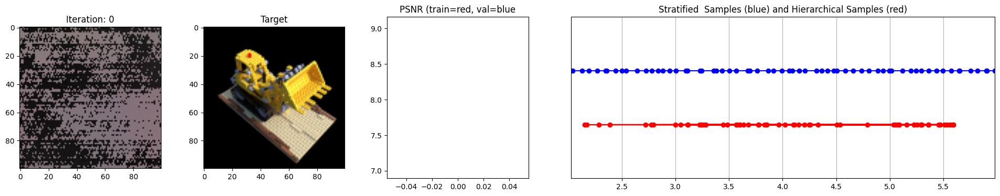

  1%|          | 100/10000 [00:13<34:58,  4.72it/s]

Loss: 0.0800648108124733


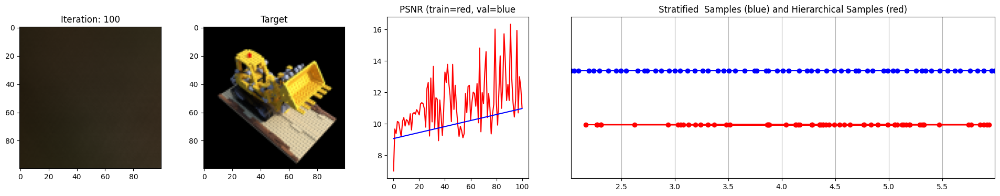

  2%|▏         | 200/10000 [00:35<34:44,  4.70it/s]

Loss: 0.07020875811576843


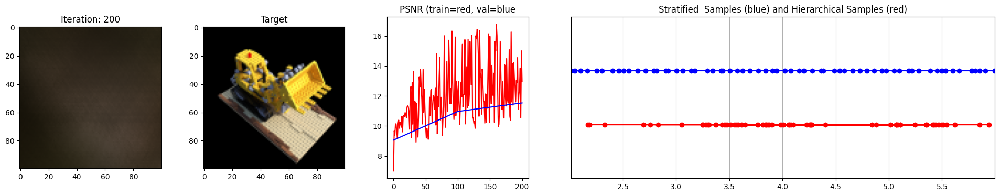

  3%|▎         | 300/10000 [00:57<34:26,  4.69it/s]

Loss: 0.03464062884449959


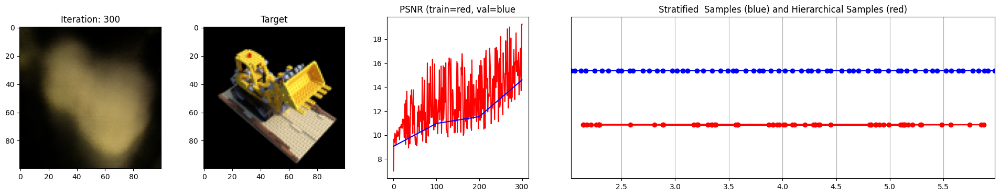

  4%|▍         | 400/10000 [01:19<34:04,  4.70it/s]

Loss: 0.024078629910945892


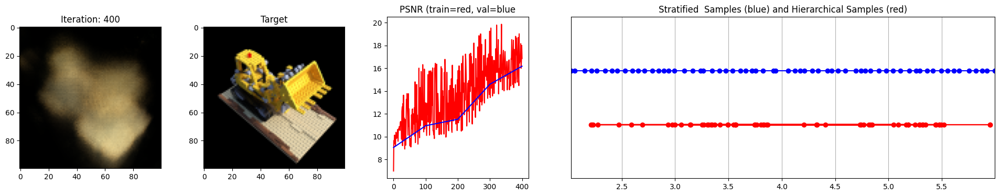

  5%|▌         | 500/10000 [01:40<33:50,  4.68it/s]

Loss: 0.020549403503537178


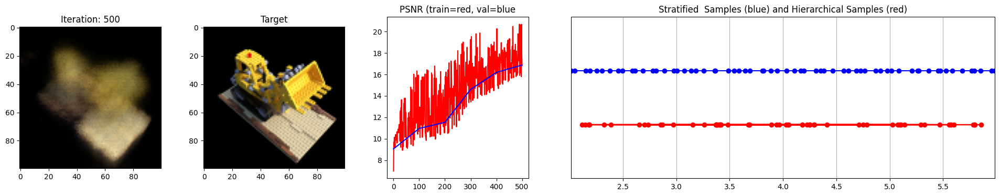

  6%|▌         | 600/10000 [02:02<33:25,  4.69it/s]

Loss: 0.0178051944822073


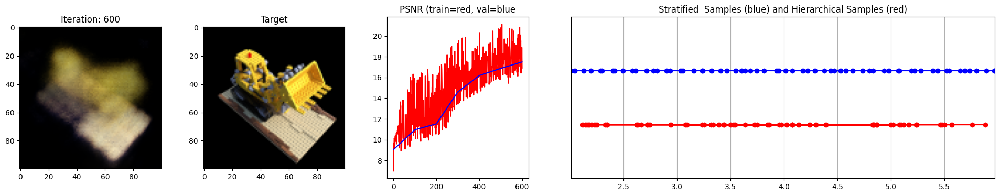

  7%|▋         | 700/10000 [02:24<33:03,  4.69it/s]

Loss: 0.01570034958422184


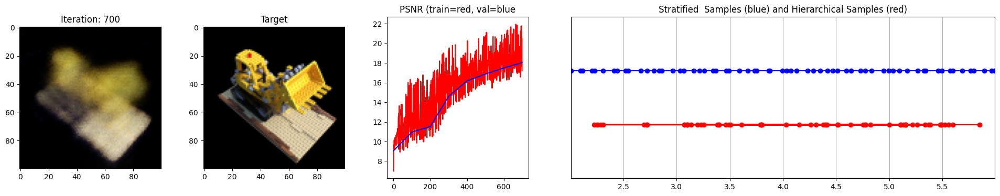

  8%|▊         | 800/10000 [02:46<32:46,  4.68it/s]

Loss: 0.0169249065220356


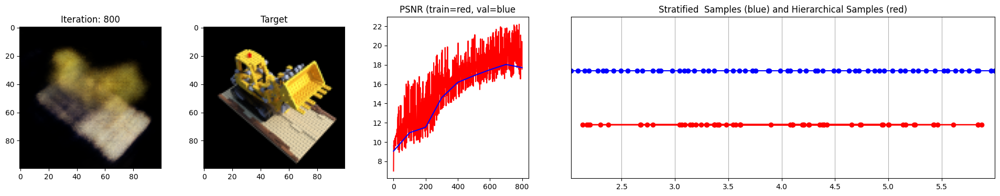

  9%|▉         | 900/10000 [03:07<32:25,  4.68it/s]

Loss: 0.014133046381175518


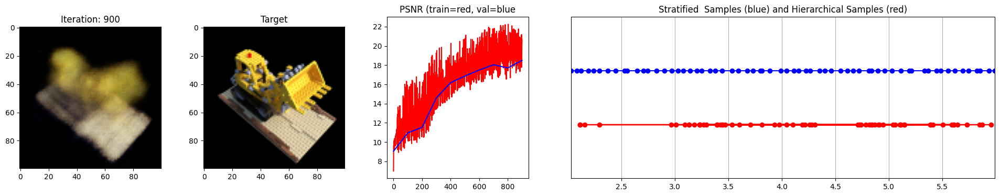

 10%|█         | 1000/10000 [03:29<32:02,  4.68it/s]

Loss: 0.011944277212023735


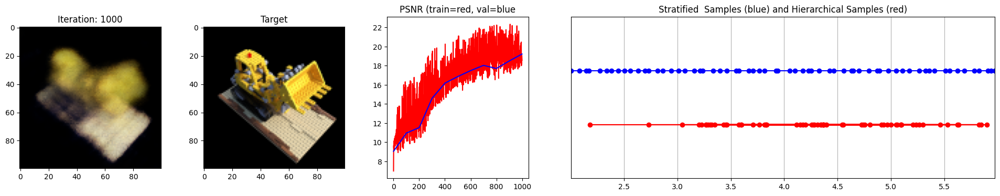

 11%|█         | 1100/10000 [03:51<31:37,  4.69it/s]

Loss: 0.011350110173225403


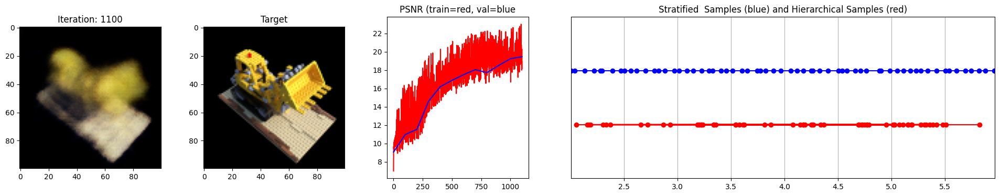

 12%|█▏        | 1200/10000 [04:13<31:17,  4.69it/s]

Loss: 0.012648887000977993


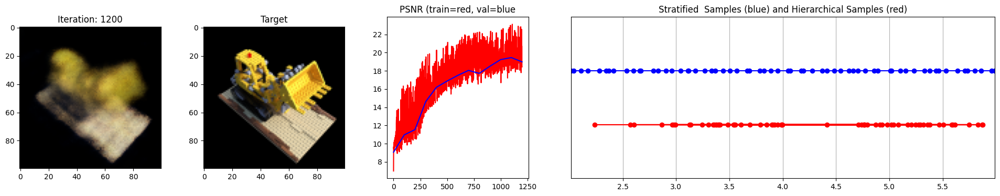

 13%|█▎        | 1300/10000 [04:35<30:57,  4.68it/s]

Loss: 0.011265459470450878


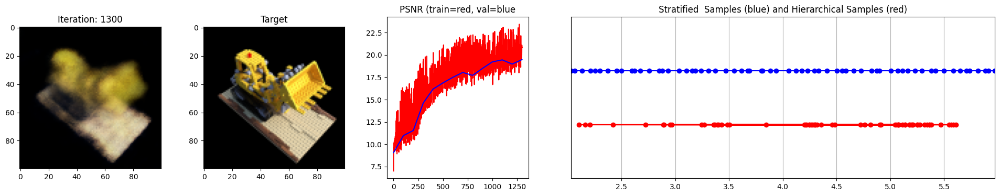

 14%|█▍        | 1400/10000 [04:56<30:38,  4.68it/s]

Loss: 0.010969125665724277


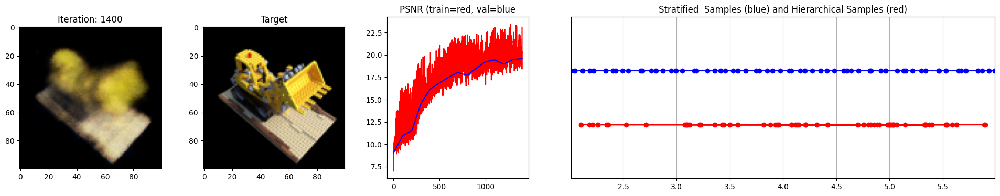

 15%|█▌        | 1500/10000 [05:18<30:15,  4.68it/s]

Loss: 0.01172452699393034


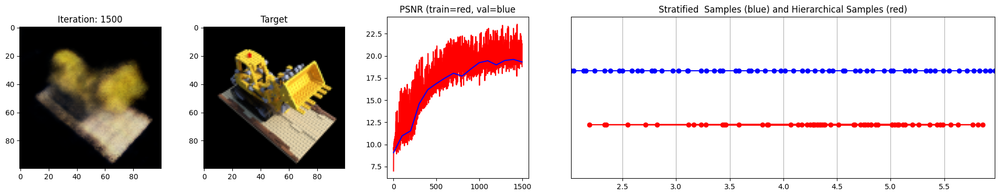

 16%|█▌        | 1600/10000 [05:40<29:54,  4.68it/s]

Loss: 0.010603437200188637


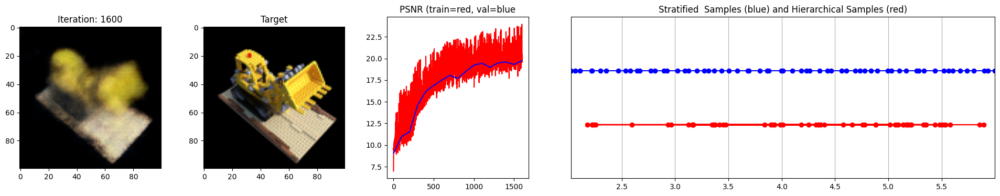

 17%|█▋        | 1700/10000 [06:02<29:33,  4.68it/s]

Loss: 0.009734394028782845


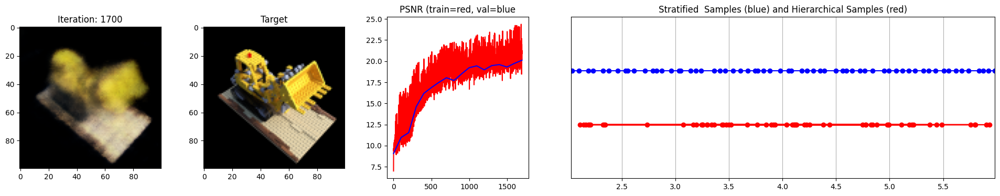

 18%|█▊        | 1800/10000 [06:24<29:12,  4.68it/s]

Loss: 0.009876955300569534


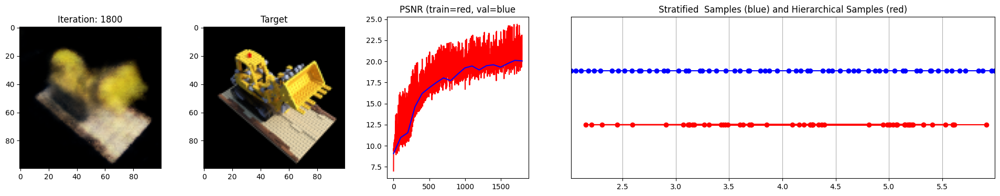

 19%|█▉        | 1900/10000 [06:45<28:51,  4.68it/s]

Loss: 0.009503094479441643


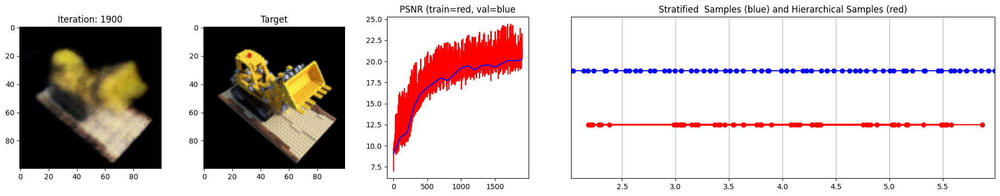

 20%|██        | 2000/10000 [07:07<28:30,  4.68it/s]

Loss: 0.009781301021575928


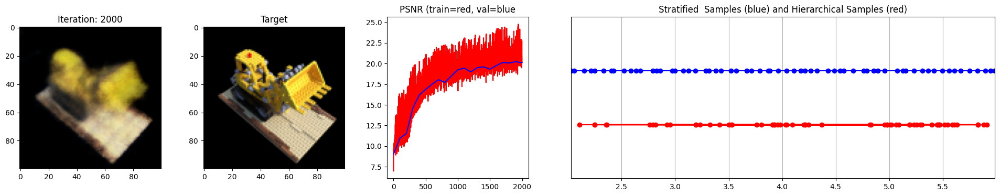

 21%|██        | 2100/10000 [07:29<28:04,  4.69it/s]

Loss: 0.009325911290943623


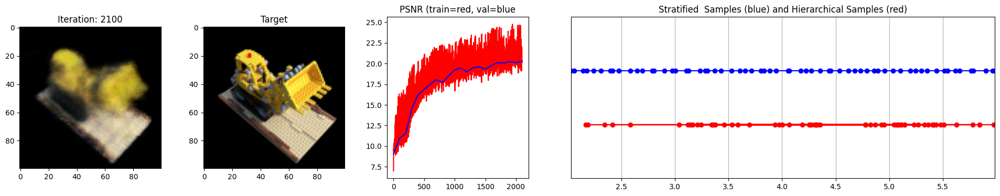

 22%|██▏       | 2200/10000 [07:51<27:43,  4.69it/s]

Loss: 0.009178977459669113


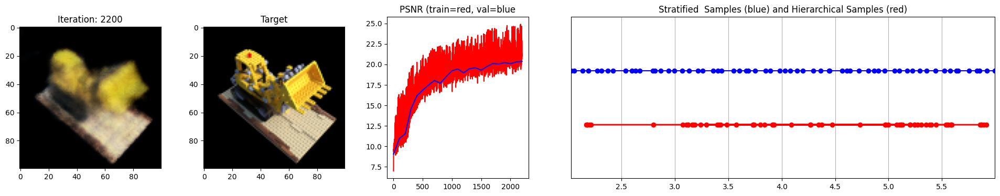

 23%|██▎       | 2300/10000 [08:12<27:22,  4.69it/s]

Loss: 0.009381317533552647


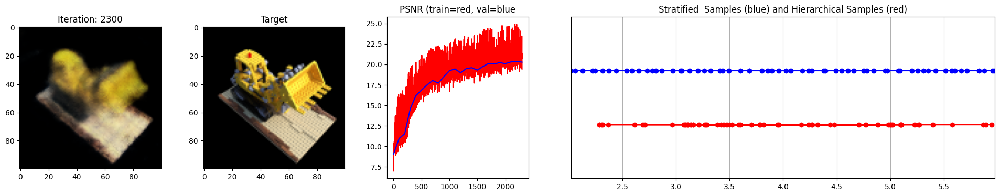

 24%|██▍       | 2400/10000 [08:34<27:01,  4.69it/s]

Loss: 0.009488140232861042


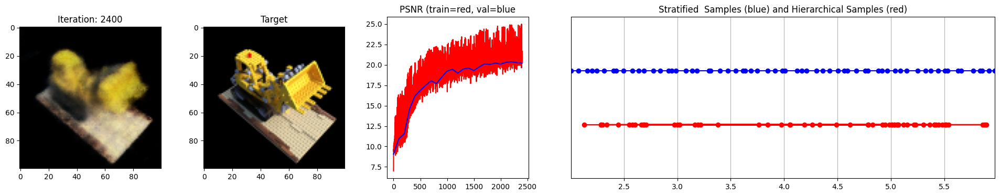

 25%|██▌       | 2500/10000 [08:56<26:40,  4.68it/s]

Loss: 0.008567692711949348


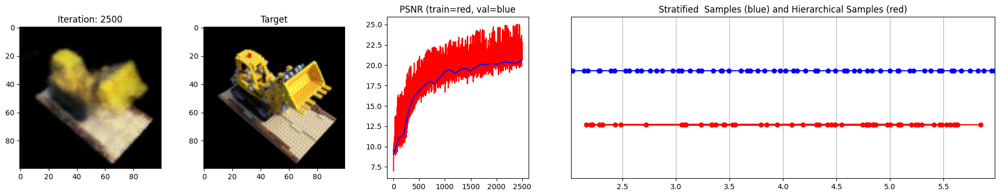

 26%|██▌       | 2600/10000 [09:18<26:19,  4.68it/s]

Loss: 0.008021850138902664


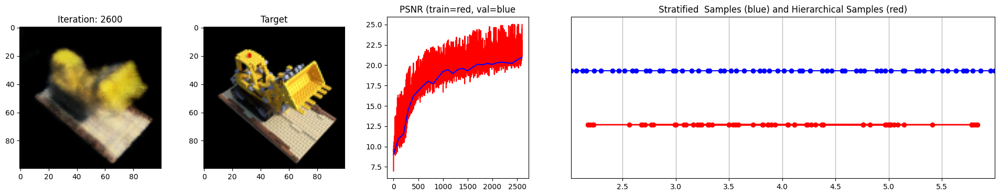

 27%|██▋       | 2700/10000 [09:40<25:58,  4.69it/s]

Loss: 0.008775816299021244


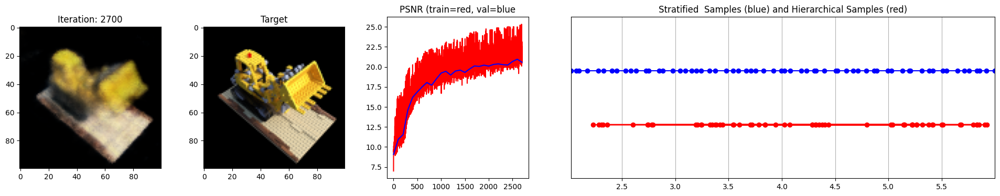

 28%|██▊       | 2800/10000 [10:01<25:38,  4.68it/s]

Loss: 0.008072905242443085


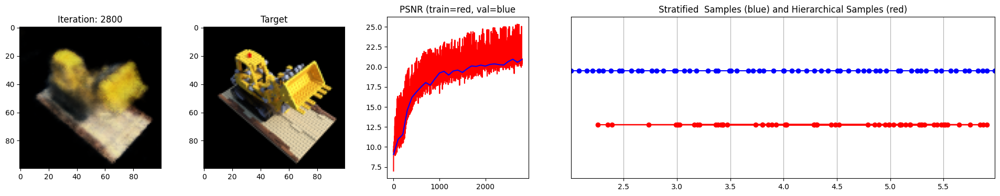

 29%|██▉       | 2900/10000 [10:23<25:14,  4.69it/s]

Loss: 0.007699307519942522


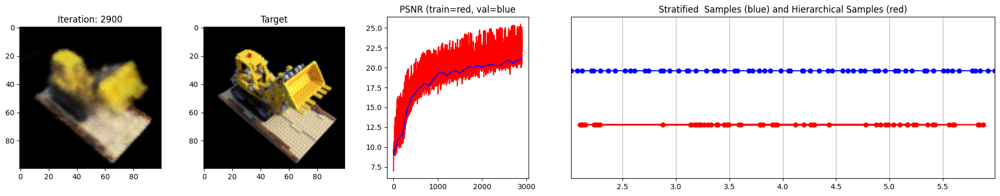

 30%|███       | 3000/10000 [10:45<24:55,  4.68it/s]

Loss: 0.00784700084477663


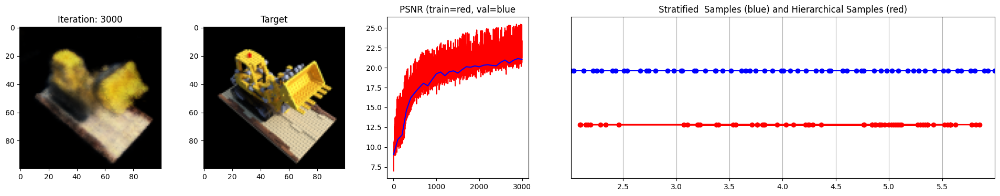

 31%|███       | 3100/10000 [11:07<24:33,  4.68it/s]

Loss: 0.007533211726695299


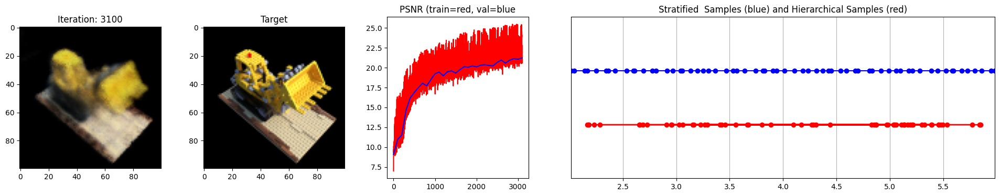

 32%|███▏      | 3200/10000 [11:29<24:10,  4.69it/s]

Loss: 0.007440268062055111


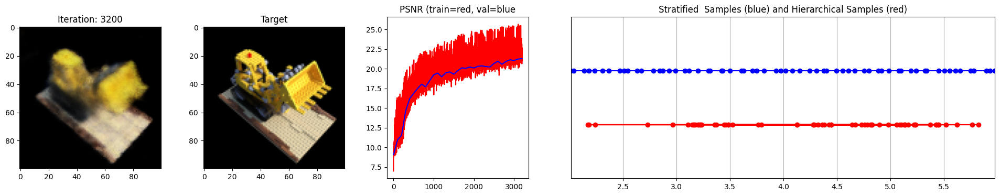

 33%|███▎      | 3300/10000 [11:50<23:50,  4.69it/s]

Loss: 0.0073281642980873585


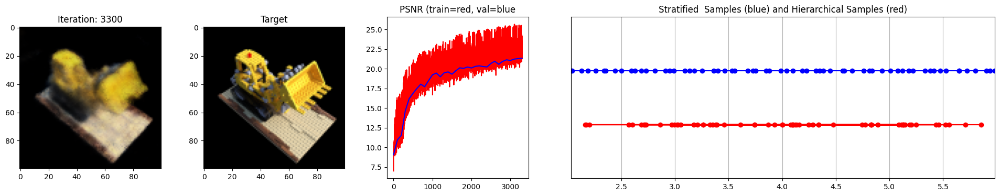

 34%|███▍      | 3400/10000 [12:12<23:31,  4.68it/s]

Loss: 0.007235463708639145


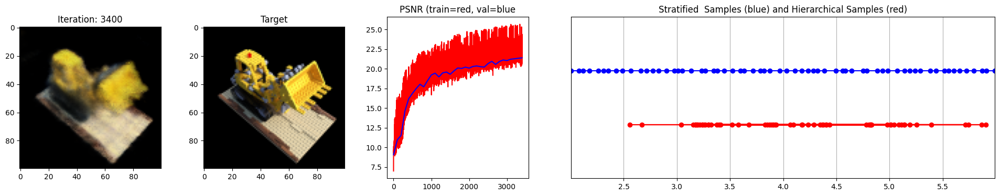

 35%|███▌      | 3500/10000 [12:34<23:08,  4.68it/s]

Loss: 0.00694349966943264


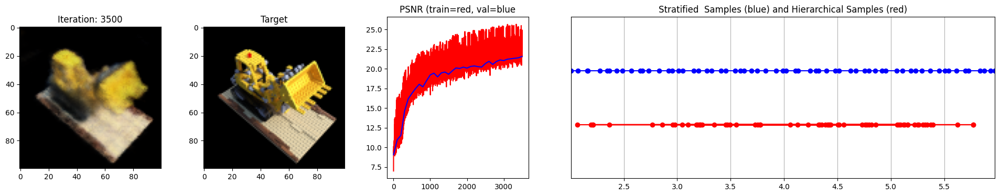

 36%|███▌      | 3600/10000 [12:56<22:48,  4.68it/s]

Loss: 0.007703924551606178


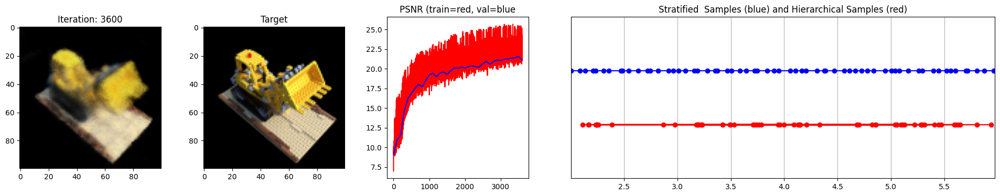

 37%|███▋      | 3700/10000 [13:18<22:25,  4.68it/s]

Loss: 0.006958710961043835


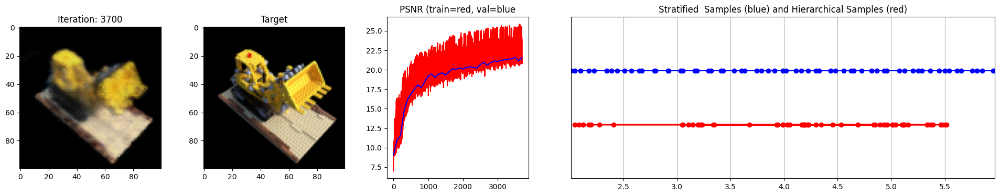

 38%|███▊      | 3800/10000 [13:39<22:05,  4.68it/s]

Loss: 0.007600380107760429


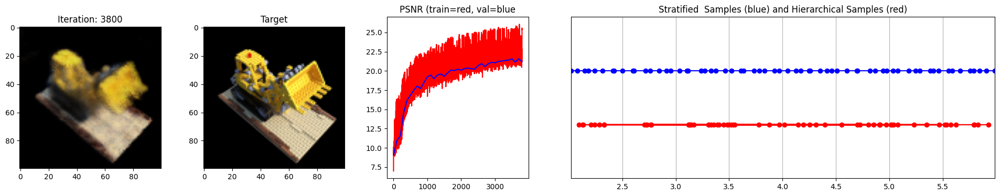

 39%|███▉      | 3900/10000 [14:01<21:40,  4.69it/s]

Loss: 0.006817754358053207


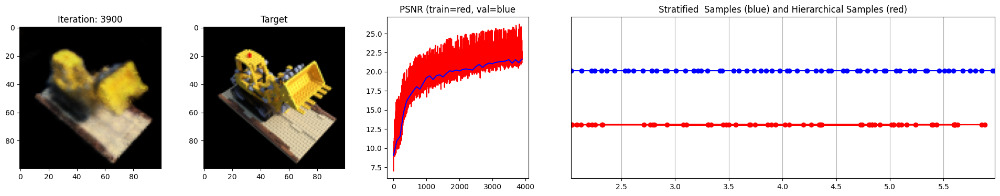

 40%|████      | 4000/10000 [14:23<21:21,  4.68it/s]

Loss: 0.006982878781855106


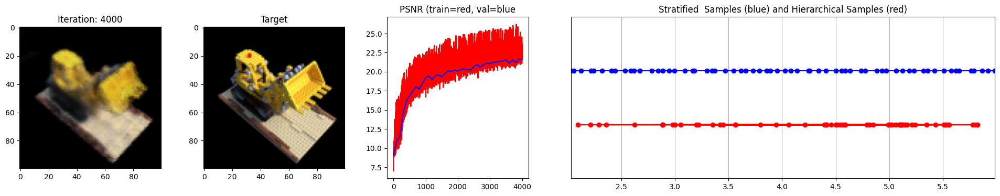

 41%|████      | 4100/10000 [14:45<21:00,  4.68it/s]

Loss: 0.006274502258747816


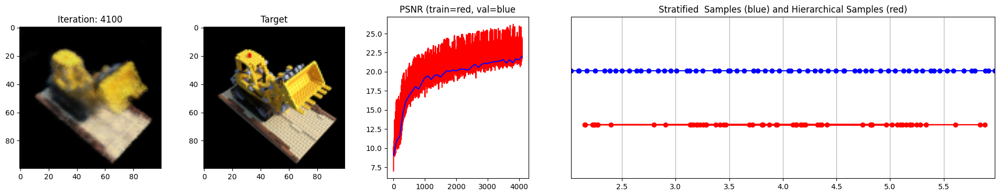

 42%|████▏     | 4200/10000 [15:07<20:39,  4.68it/s]

Loss: 0.006468561943620443


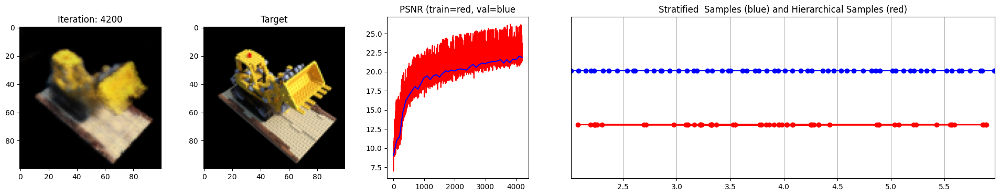

 43%|████▎     | 4300/10000 [15:28<20:16,  4.69it/s]

Loss: 0.00694309314712882


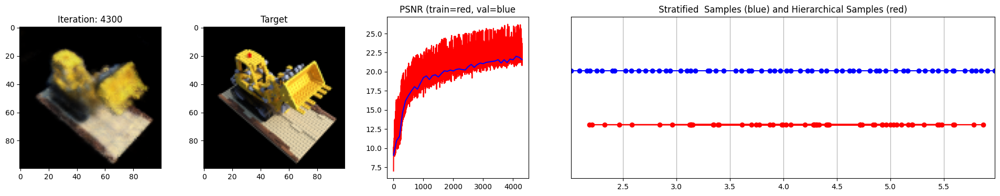

 44%|████▍     | 4400/10000 [15:50<19:56,  4.68it/s]

Loss: 0.006455705035477877


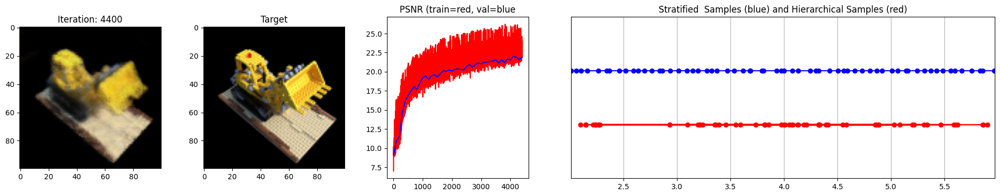

 45%|████▌     | 4500/10000 [16:12<19:36,  4.68it/s]

Loss: 0.006410557311028242


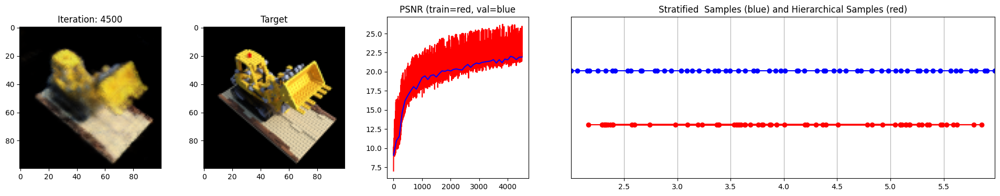

 46%|████▌     | 4600/10000 [16:34<19:13,  4.68it/s]

Loss: 0.0059526520781219006


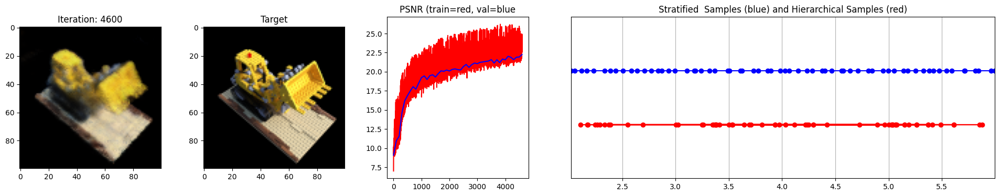

 47%|████▋     | 4700/10000 [16:56<18:51,  4.68it/s]

Loss: 0.006269775331020355


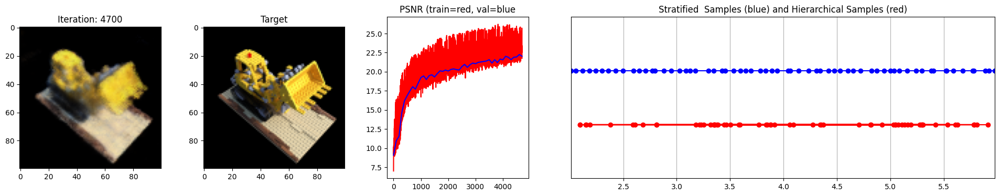

 48%|████▊     | 4800/10000 [17:17<18:29,  4.69it/s]

Loss: 0.0058793905191123486


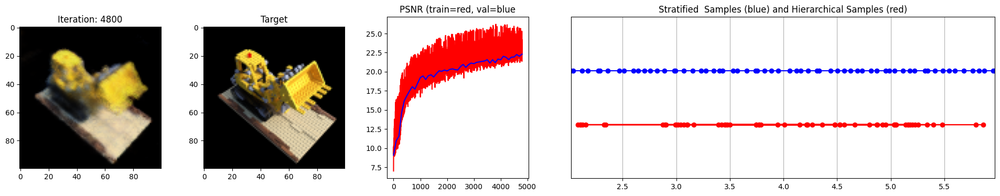

 49%|████▉     | 4900/10000 [17:39<18:07,  4.69it/s]

Loss: 0.005868422798812389


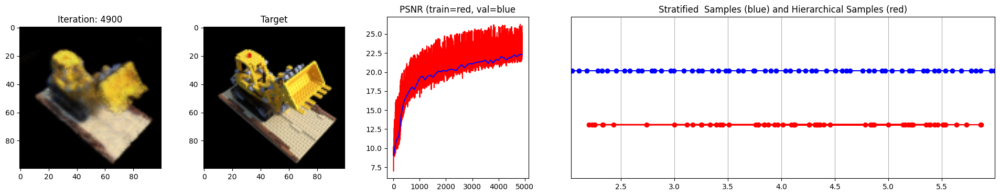

 50%|█████     | 5000/10000 [18:01<17:48,  4.68it/s]

Loss: 0.005952829960733652


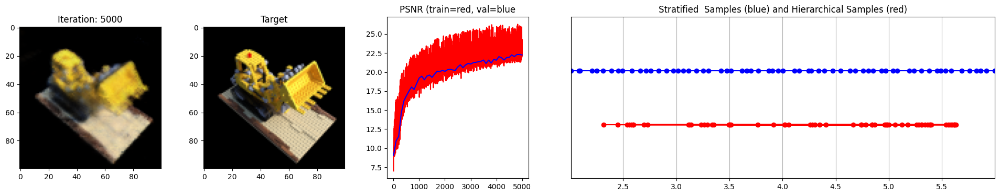

 51%|█████     | 5100/10000 [18:23<17:25,  4.69it/s]

Loss: 0.006026014219969511


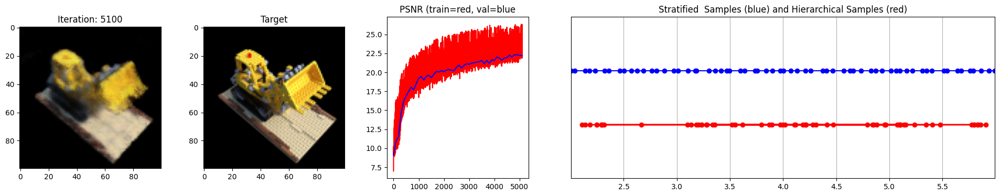

 52%|█████▏    | 5200/10000 [18:45<17:06,  4.68it/s]

Loss: 0.00597232673317194


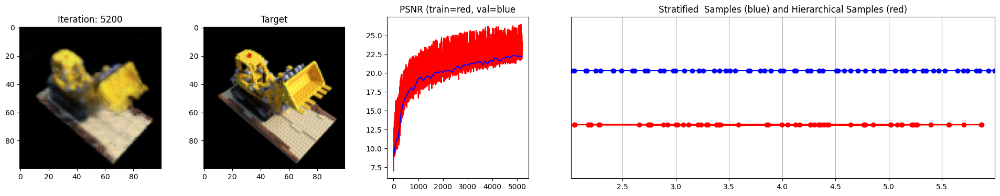

 53%|█████▎    | 5300/10000 [19:06<16:44,  4.68it/s]

Loss: 0.0057450635358691216


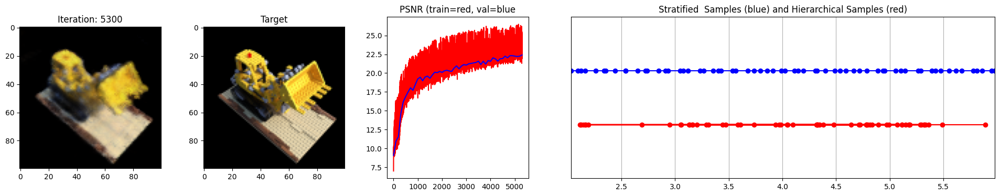

 54%|█████▍    | 5400/10000 [19:28<16:22,  4.68it/s]

Loss: 0.005480979569256306


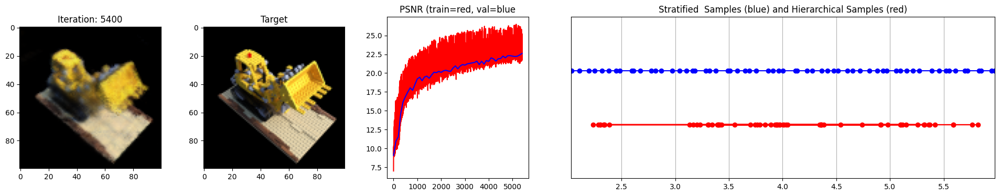

 55%|█████▌    | 5500/10000 [19:50<16:02,  4.67it/s]

Loss: 0.007146723102778196


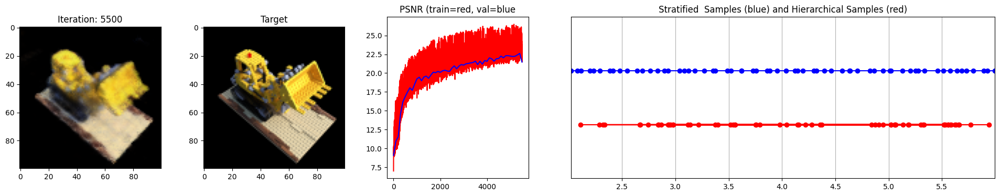

 56%|█████▌    | 5600/10000 [20:12<15:41,  4.68it/s]

Loss: 0.0058627803809940815


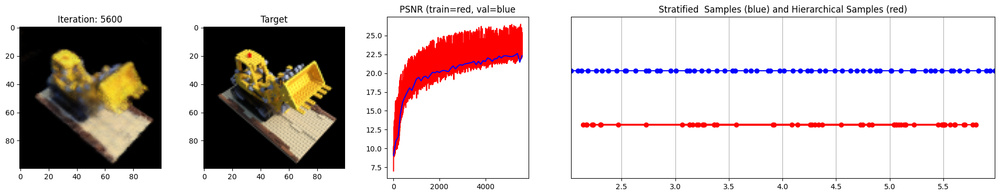

 57%|█████▋    | 5700/10000 [20:34<15:18,  4.68it/s]

Loss: 0.00581764243543148


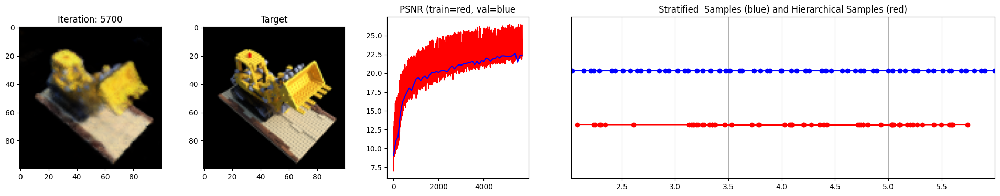

 58%|█████▊    | 5800/10000 [20:56<14:55,  4.69it/s]

Loss: 0.005680490285158157


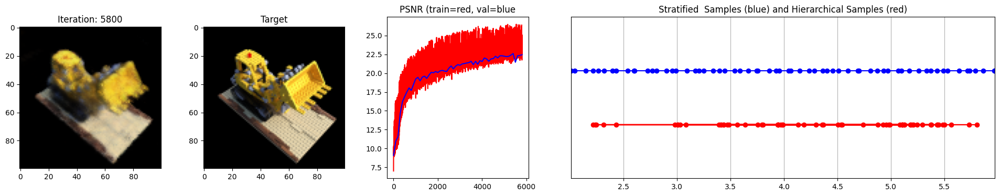

 59%|█████▉    | 5900/10000 [21:17<14:35,  4.68it/s]

Loss: 0.005520903971046209


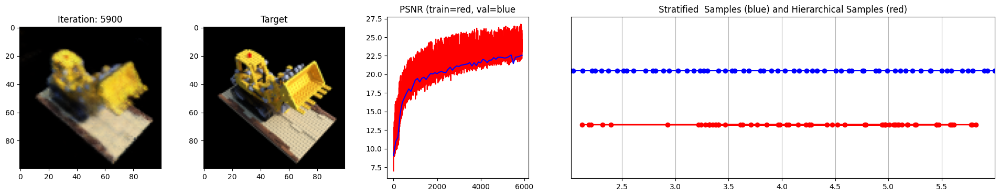

 60%|██████    | 6000/10000 [21:39<14:14,  4.68it/s]

Loss: 0.005520617589354515


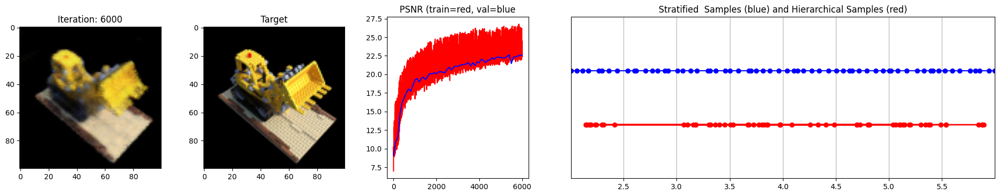

 61%|██████    | 6100/10000 [22:01<13:52,  4.69it/s]

Loss: 0.005917438771575689


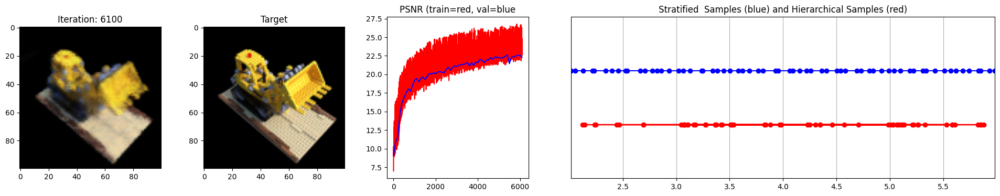

 62%|██████▏   | 6200/10000 [22:23<13:31,  4.68it/s]

Loss: 0.005199593957513571


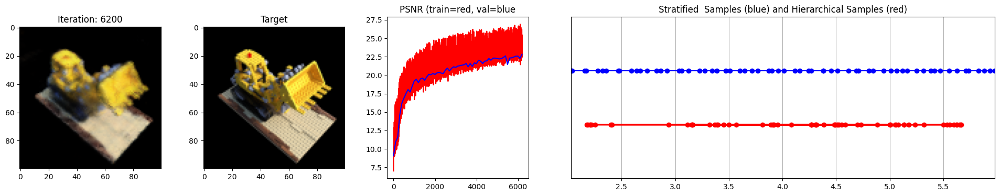

 63%|██████▎   | 6300/10000 [22:45<13:12,  4.67it/s]

Loss: 0.005005569662898779


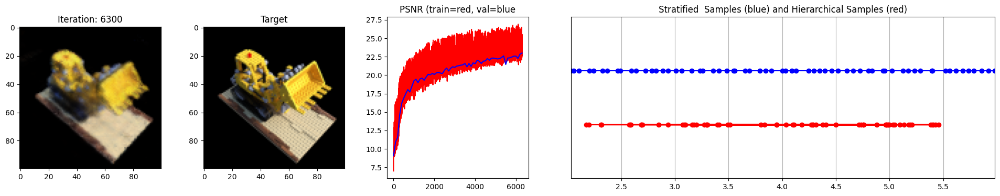

 64%|██████▍   | 6400/10000 [23:06<12:48,  4.68it/s]

Loss: 0.004986348561942577


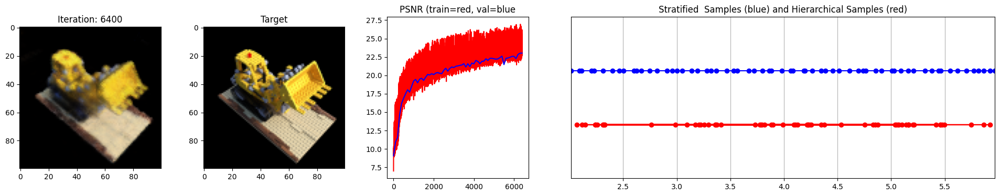

 65%|██████▌   | 6500/10000 [23:28<12:27,  4.68it/s]

Loss: 0.005496257450431585


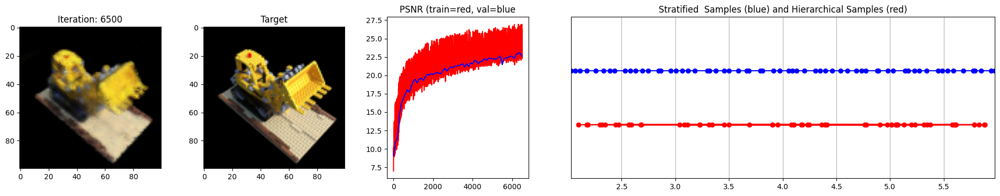

 66%|██████▌   | 6600/10000 [23:50<12:06,  4.68it/s]

Loss: 0.005153995007276535


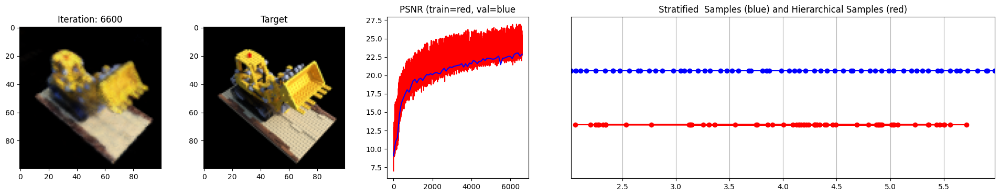

 67%|██████▋   | 6700/10000 [24:12<11:44,  4.68it/s]

Loss: 0.004947572946548462


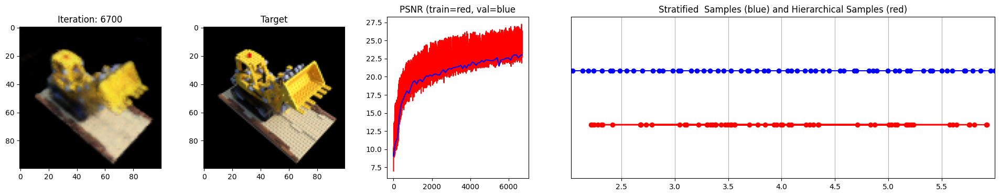

 68%|██████▊   | 6800/10000 [24:33<11:22,  4.69it/s]

Loss: 0.005298533011227846


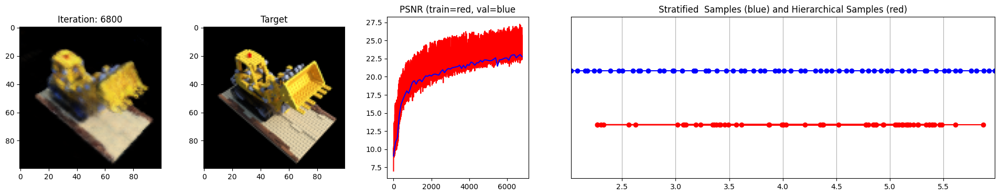

 69%|██████▉   | 6900/10000 [24:55<11:01,  4.68it/s]

Loss: 0.004610830452293158


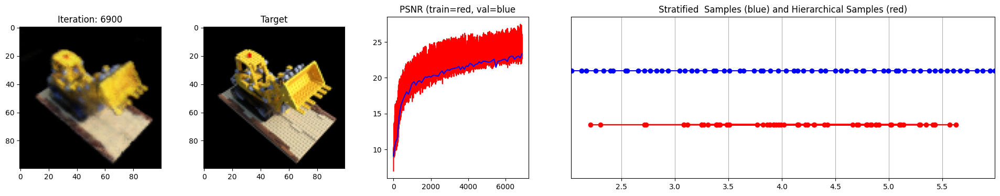

 70%|███████   | 7000/10000 [25:17<10:40,  4.68it/s]

Loss: 0.0048718382604420185


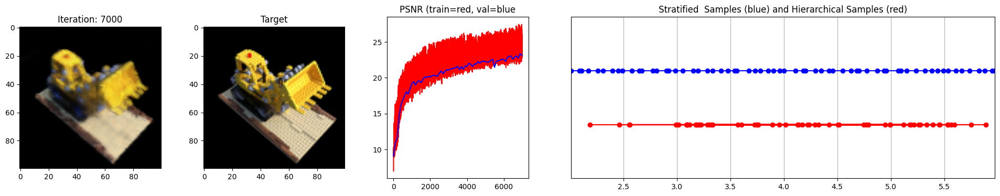

 71%|███████   | 7100/10000 [25:39<10:19,  4.68it/s]

Loss: 0.0048113251104950905


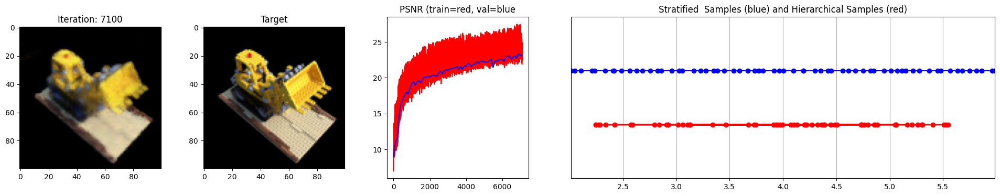

 72%|███████▏  | 7200/10000 [26:01<09:57,  4.68it/s]

Loss: 0.004644658882170916


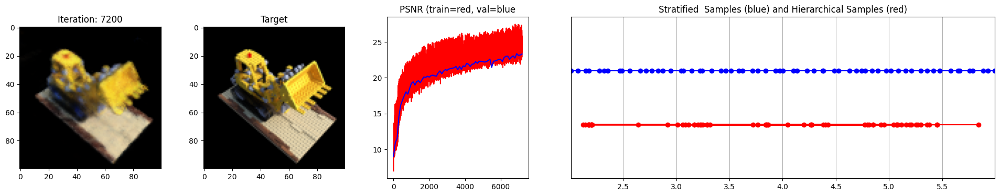

 73%|███████▎  | 7300/10000 [26:22<09:36,  4.68it/s]

Loss: 0.00512500898912549


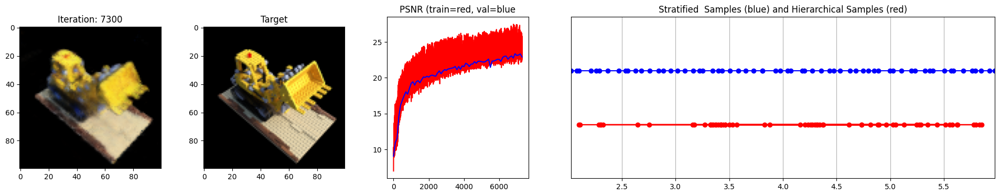

 74%|███████▍  | 7400/10000 [26:44<09:16,  4.67it/s]

Loss: 0.004572459030896425


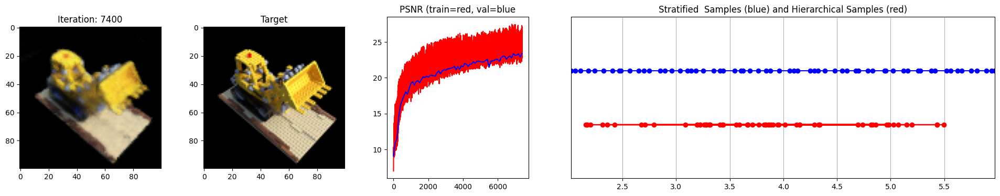

 75%|███████▌  | 7500/10000 [27:06<08:53,  4.69it/s]

Loss: 0.004884899128228426


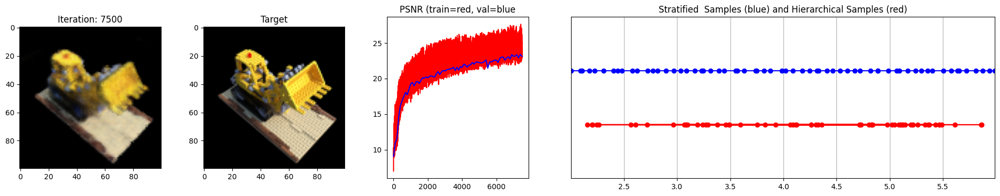

 76%|███████▌  | 7600/10000 [27:28<08:35,  4.66it/s]

Loss: 0.005032230634242296


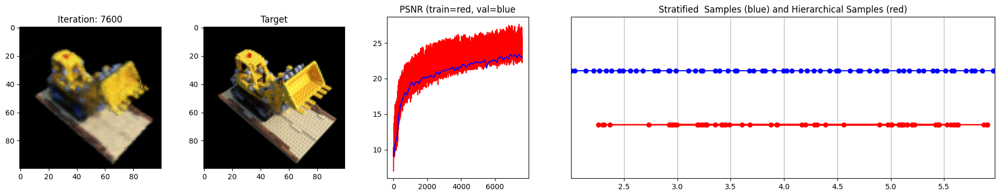

 77%|███████▋  | 7700/10000 [27:50<08:11,  4.68it/s]

Loss: 0.004852143116295338


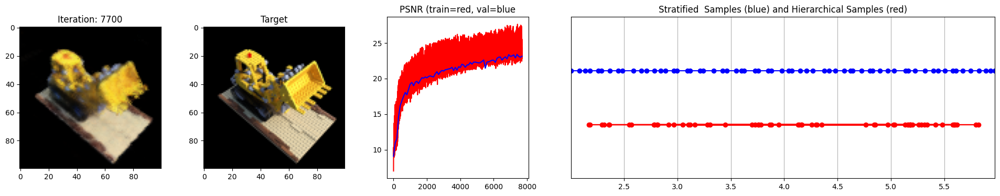

 78%|███████▊  | 7800/10000 [28:11<07:49,  4.68it/s]

Loss: 0.004904486238956451


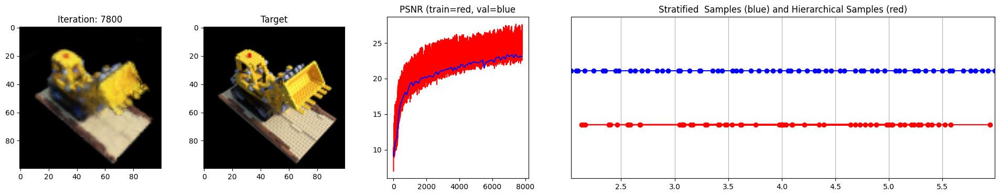

 79%|███████▉  | 7900/10000 [28:33<07:28,  4.69it/s]

Loss: 0.0042572650127112865


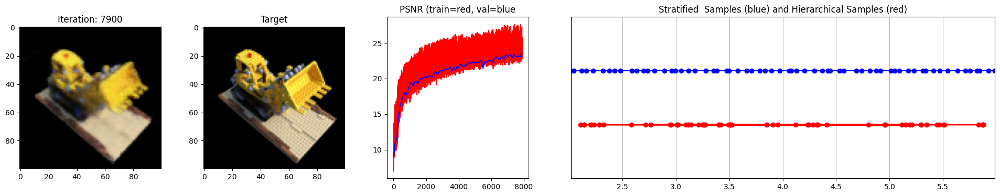

 80%|████████  | 8000/10000 [28:55<07:07,  4.68it/s]

Loss: 0.0049080210737884045


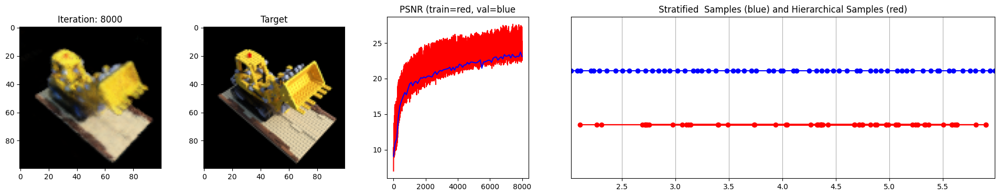

 81%|████████  | 8100/10000 [29:17<06:46,  4.68it/s]

Loss: 0.004556200001388788


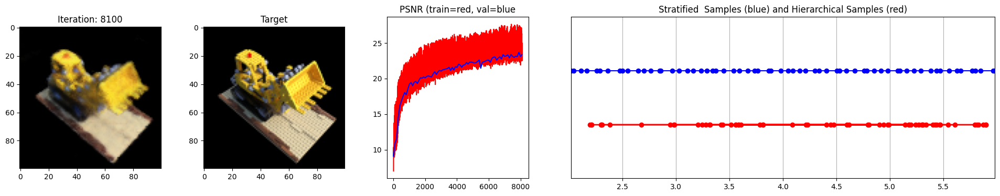

 82%|████████▏ | 8200/10000 [29:38<06:24,  4.68it/s]

Loss: 0.00429505342617631


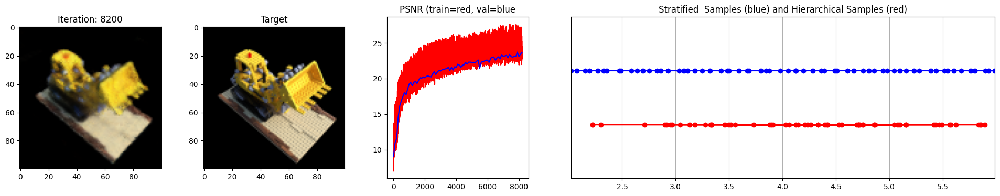

 83%|████████▎ | 8300/10000 [30:00<06:03,  4.68it/s]

Loss: 0.004280807450413704


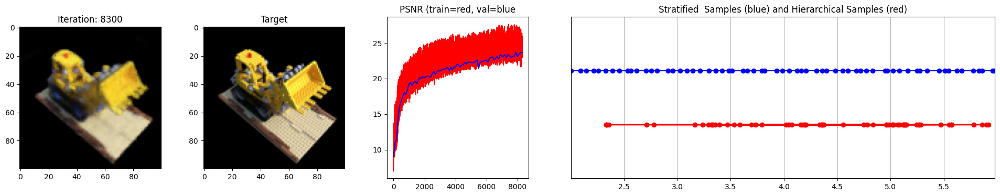

 84%|████████▍ | 8400/10000 [30:22<05:41,  4.68it/s]

Loss: 0.004389427602291107


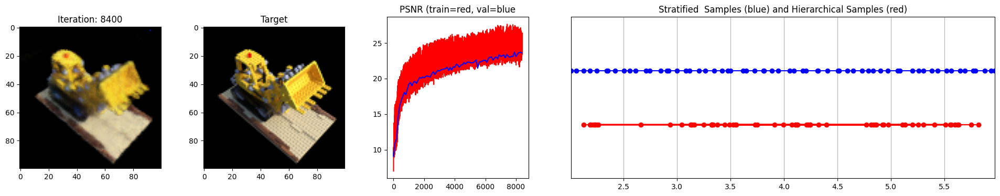

 85%|████████▌ | 8500/10000 [30:44<05:19,  4.69it/s]

Loss: 0.004617251455783844


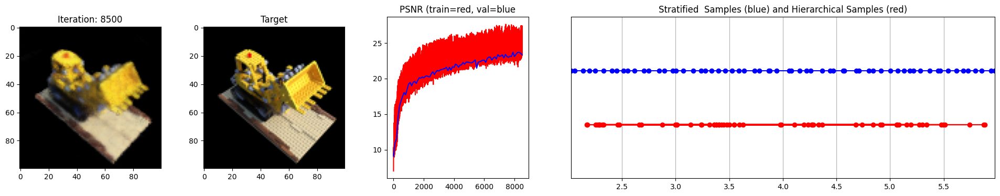

 86%|████████▌ | 8600/10000 [31:06<04:58,  4.69it/s]

Loss: 0.004459353629499674


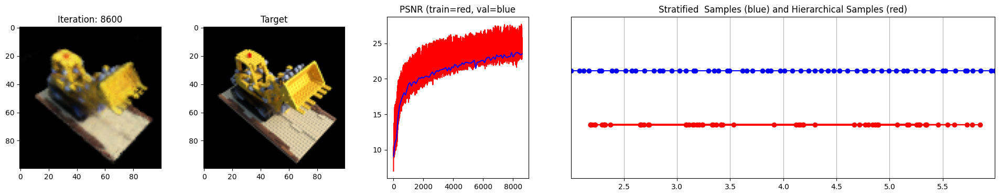

 87%|████████▋ | 8700/10000 [31:27<04:37,  4.68it/s]

Loss: 0.004564437549561262


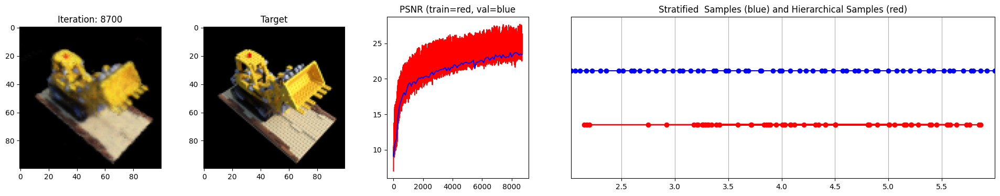

 88%|████████▊ | 8800/10000 [31:49<04:16,  4.68it/s]

Loss: 0.004120354074984789


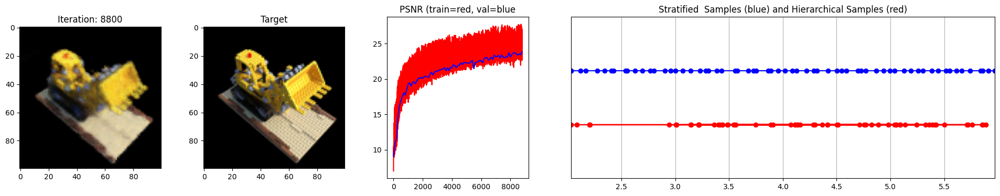

 89%|████████▉ | 8900/10000 [32:11<03:54,  4.69it/s]

Loss: 0.004229821264743805


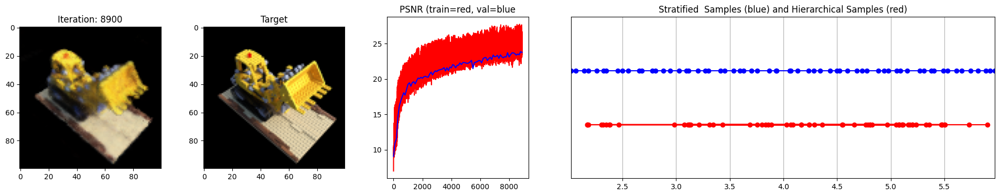

 90%|█████████ | 9000/10000 [32:33<03:33,  4.68it/s]

Loss: 0.004269764292985201


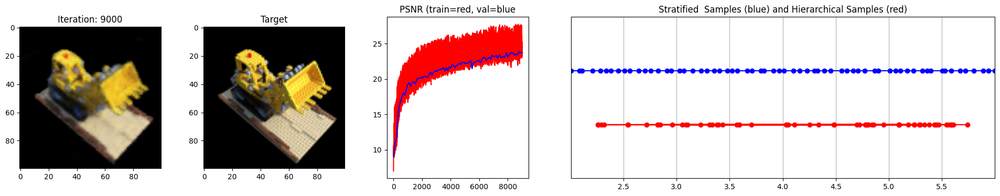

 91%|█████████ | 9100/10000 [32:55<03:12,  4.68it/s]

Loss: 0.004159519448876381


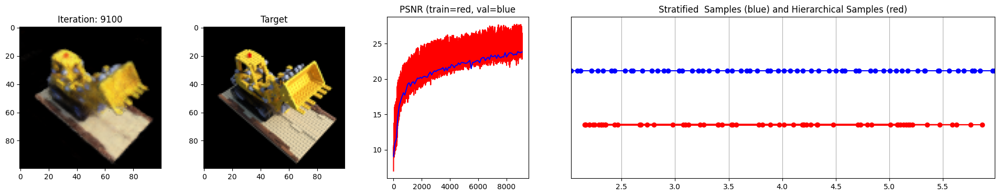

 92%|█████████▏| 9200/10000 [33:16<02:50,  4.68it/s]

Loss: 0.004331987351179123


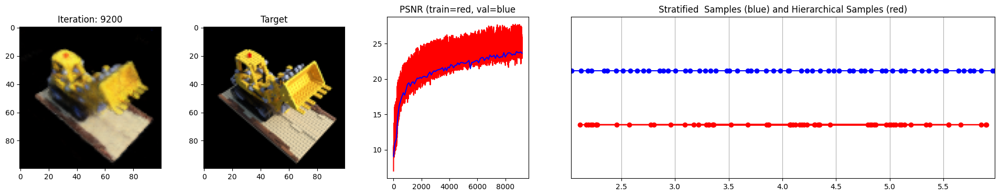

 93%|█████████▎| 9300/10000 [33:38<02:29,  4.69it/s]

Loss: 0.003986352123320103


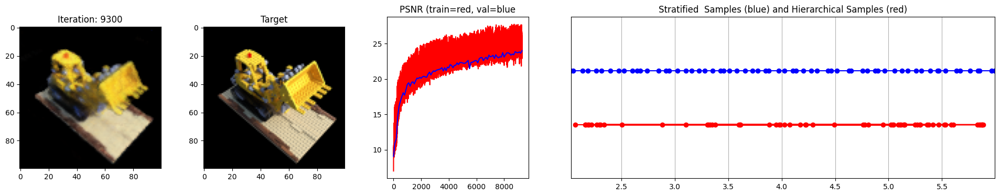

 94%|█████████▍| 9400/10000 [34:00<02:08,  4.69it/s]

Loss: 0.005013132002204657


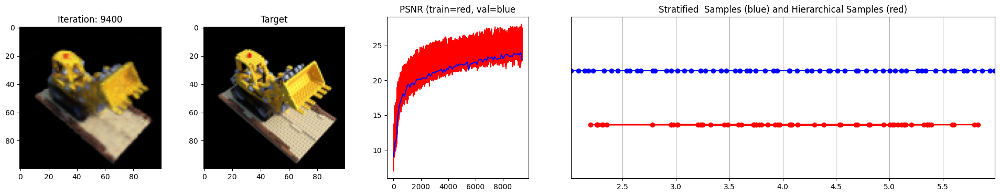

 95%|█████████▌| 9500/10000 [34:22<01:46,  4.68it/s]

Loss: 0.004564380273222923


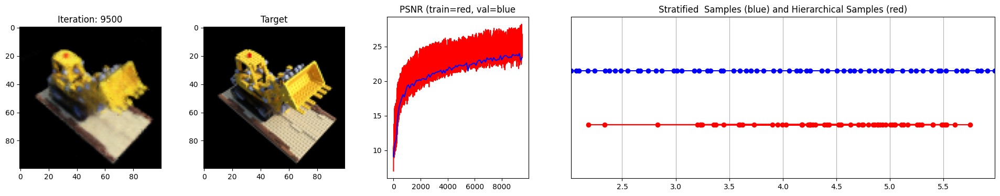

 96%|█████████▌| 9600/10000 [34:44<01:25,  4.68it/s]

Loss: 0.004252712242305279


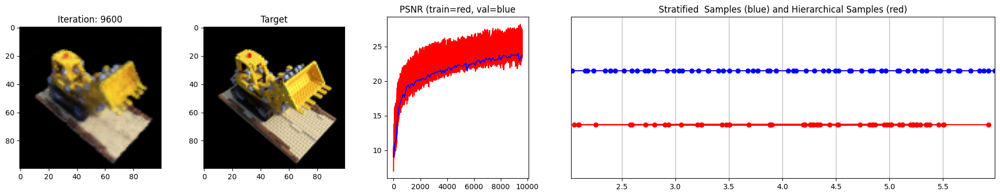

 97%|█████████▋| 9700/10000 [35:05<01:04,  4.68it/s]

Loss: 0.004366233013570309


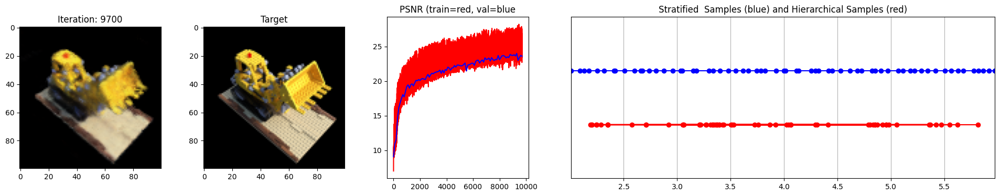

 98%|█████████▊| 9800/10000 [35:27<00:42,  4.68it/s]

Loss: 0.0040713828057050705


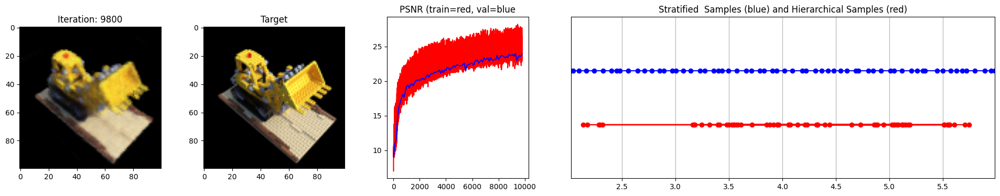

 99%|█████████▉| 9900/10000 [35:49<00:21,  4.68it/s]

Loss: 0.004177568946033716


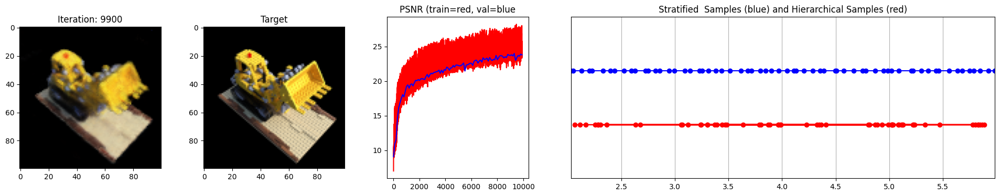

100%|██████████| 10000/10000 [36:11<00:00,  4.61it/s]

Training successful!

Done!


In [108]:
# Run training session(s)
for _ in range(n_restarts):
  model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()
  success, train_psnrs, val_psnrs = train()
  if success and val_psnrs[-1] >= warmup_min_fitness:
    print('Training successful!')
    break

print('')
print(f'Done!')

In [ ]:
torch.save(model.state_dict(), 'nerf.pt')
torch.save(fine_model.state_dict(), 'nerf-fine.pt')